In [1]:
import json
import re
import random
import matplotlib.pyplot as plt
import lightgbm as lgb
import pandas as pd
import numpy as np
import pyarrow.parquet as pq
import pyarrow as pa
from collections import defaultdict
from email_prediction import (
    build_feature_matrix,
    split_clean_ids,
    feature_matrix_batch_loader,
)
from db import TableName, read_table
from sqlalchemy import select, func
from db.models import _TABLE_LOOKUP, get_engine, TableName
from sklearn.metrics import precision_score, recall_score, f1_score
from livelossplot import PlotLosses
from db.db import init_db

In [2]:
RUN_FEATURE_BUILD = False

# Model Development
This notebook is to note and document the development of the LightGBM powered email template prediction. This follows on the previous Pattern Mining and EDA notebooks which informed the methodology used here.

# Feature Engineering

Previous work has informed this approach please check the other reports for context.

Each input row in the feature matrix should represent a `(name, firm, candidate_template)` triple. For each triple, we want to generate:

* **Investor name features** (e.g. multiple first names, presence of middle name)
* **Template structural features** (e.g. nickname support, in mined rules)
* **Firm-template features** (e.g. diversity ratio, prior template frequency)

Since the project focuses on LP data, we will work with the `lp_clean` dataset solely with possible extensions to incoporate the GP dataset with the same methodolgy.

Let's start by loading the relevant data.

In [ ]:
# Load candidate templates, firm lookups and clean data
candidate_templates = read_table(TableName.CANDIDATE_TEMPLATES)
firm_template_map = read_table(TableName.FIRM_TEMPLATE_MAP)
lp_df = read_table(TableName.LP_CLEAN)

In [4]:
lp_df["token_seq"].isna().sum()

np.int64(0)

The current design of the feature matrix uses structural features of the investors name and firm level statistics of template coverage per candidate template, below is snippet of our features.

```python
# Construct row
rows.append(
    {
        "clean_row_id": clean_row["id"],
        "investor": clean_row["investor"],
        "firm": firm,
        "template_id": tmpl_id,
        "template_in_firm_templates": tmpl_id in firm_templates,
        "firm_is_shared_infra": clean_row["is_shared_infra"],
        "firm_is_multi_domain": clean_row["firm_is_multi_domain"],
        "investor_has_german_char": clean_row["has_german_char"],
        "investor_has_nfkd_normalized": clean_row["has_nfkd_normalized"],
        "investor_has_nickname": clean_row["has_nickname"],
        "investor_has_multiple_first_names": clean_row[
            "has_multiple_first_names"
        ],
        "investor_has_middle_name": clean_row["has_middle_name"],
        "investor_has_multiple_middle_names": clean_row[
            "has_multiple_middle_names"
        ],
        "investor_has_multiple_last_names": clean_row[
            "has_multiple_last_names"
        ],
        "template_support_count": tmpl["support_count"],
        "template_coverage_pct": tmpl["coverage_pct"],
        "template_in_mined_rules": tmpl["in_mined_rules"],
        "template_max_rule_confidence": tmpl["max_rule_confidence"],
        "template_avg_rule_confidence": tmpl["avg_rule_confidence"],
        "template_uses_middle_name": tmpl["uses_middle_name"],
        "template_uses_multiple_firsts": tmpl["uses_multiple_firsts"],
        "template_uses_multiple_middles": tmpl["uses_multiple_middles"],
        "template_uses_multiple_lasts": tmpl["uses_multiple_lasts"],
        "firm_num_templates": firm_stats.get("num_templates"),
        "firm_num_investors": firm_stats.get("num_investors"),
        "firm_diversity_ratio": firm_stats.get("diversity_ratio"),
        "firm_is_single_template": firm_stats.get("is_single_template"),
        "label": label,
    }
)
```

In [ ]:
if RUN_FEATURE_BUILD:
    init_db()
    feature_matrix = build_feature_matrix(lp_df, candidate_templates, firm_template_map)

Tables created successfully.
0 features built out of 72310
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MAT

Our features are now saved to the SQL database for resue and inspection, lets take a look at our features.

In [6]:
# Count total rows in feature_matrix
table = _TABLE_LOOKUP[TableName.FEATURE_MATRIX]
stmt = select(func.count()).select_from(table)
with get_engine().connect() as conn:
    result = conn.execute(stmt).scalar()

print("Total feature matrix rows:", result)

Total feature matrix rows: 29213240


29213240 rows in the feature matrix table, divided by 404 is 72,310 which is the number of successfully mined rows in the clean data. Lets start training a base model.

We need to batch our training data as it will not all fit in ram at once, we will do our split on clean data row IDs to isolate our training and test set and then use those IDs to get the relevant feature matrices when streaming into the model.

```python
# Generate batches
for i in range(0, len(clean_row_ids), batch_size):
    # Batch ids
    batch_ids = clean_row_ids[i: i+ batch_size]
    # Query SQL
    stmt = tbl.select().where(tbl.c.clean_row_id.in_(batch_ids))
    # Yield DataFrame
    yield pd.read_sql(stmt, engine)
```

We use a generator to batch our data into the LightGBM model, that way we can work through the data in chunks. Lets get our split, we'll do a simple 70/10/20 split, leaving 5 fold CV and stratifying by domain untill later.

In [3]:
# Split data
train, val, test = split_clean_ids(lp_df, test_ratio=0.4, validation_ratio=0.1)
len(train), len(test), len(val)

(36055, 28844, 7211)

To start, we will use standard parameters and tune them later.

In [8]:
# Training params
params = {"objective": "binary", "learning_rate": 0.05, "verbosity": -1}

No we can start streaming the data into the odel to see how it does. We will do a live plot to see how the model is performing.

In [4]:
def train_model(train_ids, val_ids, parameters, n_rounds=50):
    # Init liveloss
    liveloss = PlotLosses()
    precision_hist = []
    recall_hist = []
    f1_hist = []

    # Load validation set
    val_df = pd.concat(list(feature_matrix_batch_loader(val_ids, batch_size=1024)))
    X_val = val_df.drop(
        columns=["label", "clean_row_id", "investor", "firm", "template_id"]
    )
    y_val = val_df["label"]

    model = None
    batch_count = 0
    # Batch features
    for batch in feature_matrix_batch_loader(train_ids, batch_size=1024):
        batch_count += 1
        y = batch["label"]
        X = batch.drop(
            columns=["label", "clean_row_id", "investor", "firm", "template_id"]
        )
        lgb_train = lgb.Dataset(X, label=y, free_raw_data=False)

        model = lgb.train(
            params=parameters,
            train_set=lgb_train,
            num_boost_round=n_rounds,
            init_model=model,
        )

        # Validate
        y_pred = model.predict(X_val)
        y_bin = (y_pred >= 0.5).astype(int)

        # Compute metrics
        precision = precision_score(y_val, y_bin)
        recall = recall_score(y_val, y_bin)
        f1 = f1_score(y_val, y_bin)
        precision_hist.append(precision)
        recall_hist.append(recall)
        f1_hist.append(f1)

        # Plot
        logs = {
            "precision": precision,
            "recall": recall,
            "f1": f1,
        }
        # Update live plot
        liveloss.update(logs)
        liveloss.send()

    return model, precision_hist, recall_hist, f1_hist

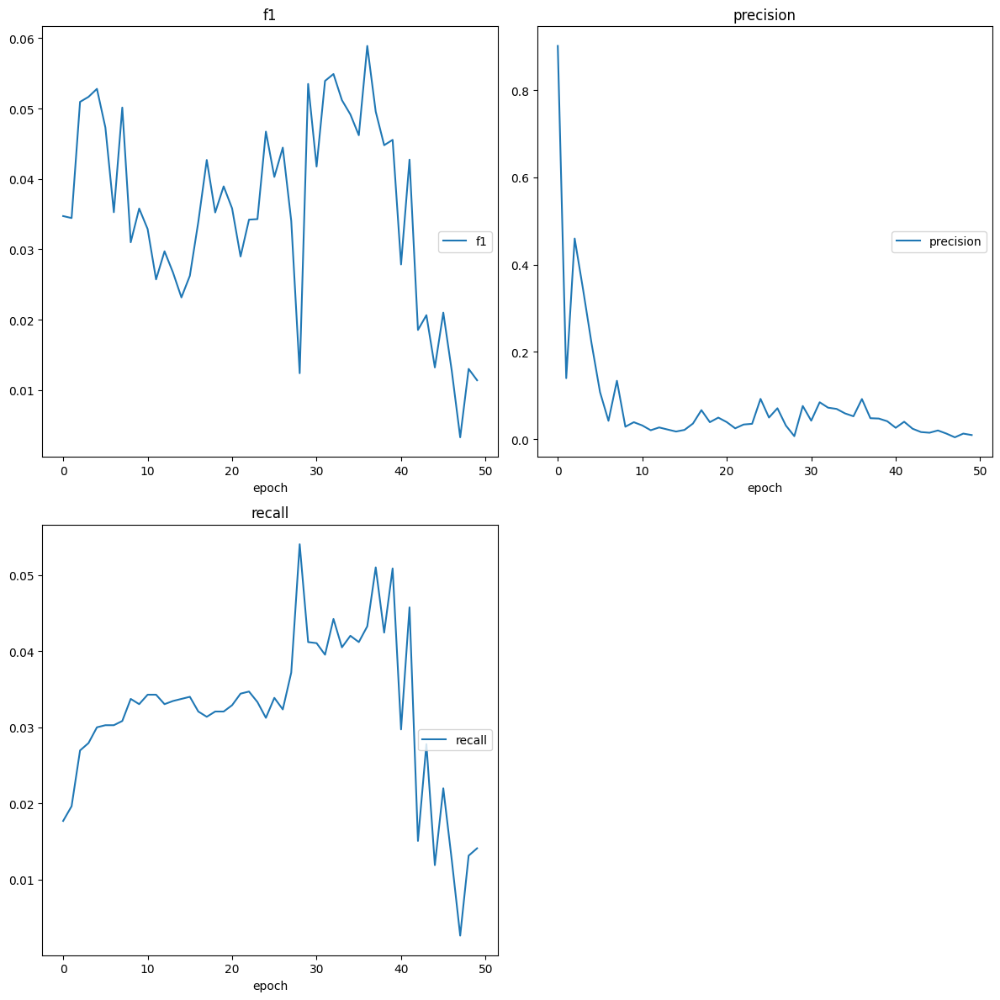

f1
	f1               	 (min:    0.003, max:    0.059, cur:    0.011)
precision
	precision        	 (min:    0.004, max:    0.901, cur:    0.010)
recall
	recall           	 (min:    0.003, max:    0.054, cur:    0.014)


(<lightgbm.basic.Booster at 0x75ba12f1f860>,
 [0.9014084507042254,
  0.1399014778325123,
  0.45990566037735847,
  0.3423728813559322,
  0.21941354903943378,
  0.10798816568047337,
  0.042212798766383966,
  0.13401442307692307,
  0.028668781576782987,
  0.039026779882429787,
  0.031584309730005096,
  0.020579205045224463,
  0.02699649836213713,
  0.022230387653867353,
  0.017636429345861945,
  0.02136158388329281,
  0.03592999845129317,
  0.06668625146886016,
  0.039076974903149736,
  0.04953031596925705,
  0.03927392739273927,
  0.02501255650426921,
  0.033732025265421316,
  0.0353061822443598,
  0.09247135842880523,
  0.04967558799675588,
  0.07095209217707701,
  0.03137758077685757,
  0.00699876492383697,
  0.07621483375959079,
  0.042464969974263654,
  0.08471563981042654,
  0.07230004518752824,
  0.06949715370018976,
  0.059190031152647975,
  0.05257586450247001,
  0.09211300765155975,
  0.0481786133960047,
  0.04739848695383665,
  0.041223255292931554,
  0.02619076623218419,
  0.0

In [ ]:
# Train the model
train_model(train, val, params)

Ok it seems this model is struggling to recover its precision. It seems to be fighting between high recall and high precision, it could be due to the class imbalance with our 404 canididate templates with only one label. I will try to use the `scale_pos_weight` to try address this imbalance before pruning the candidates from low coverage ones. We'll also lower the learning rate and increase the number of rounds to slow down the learning.

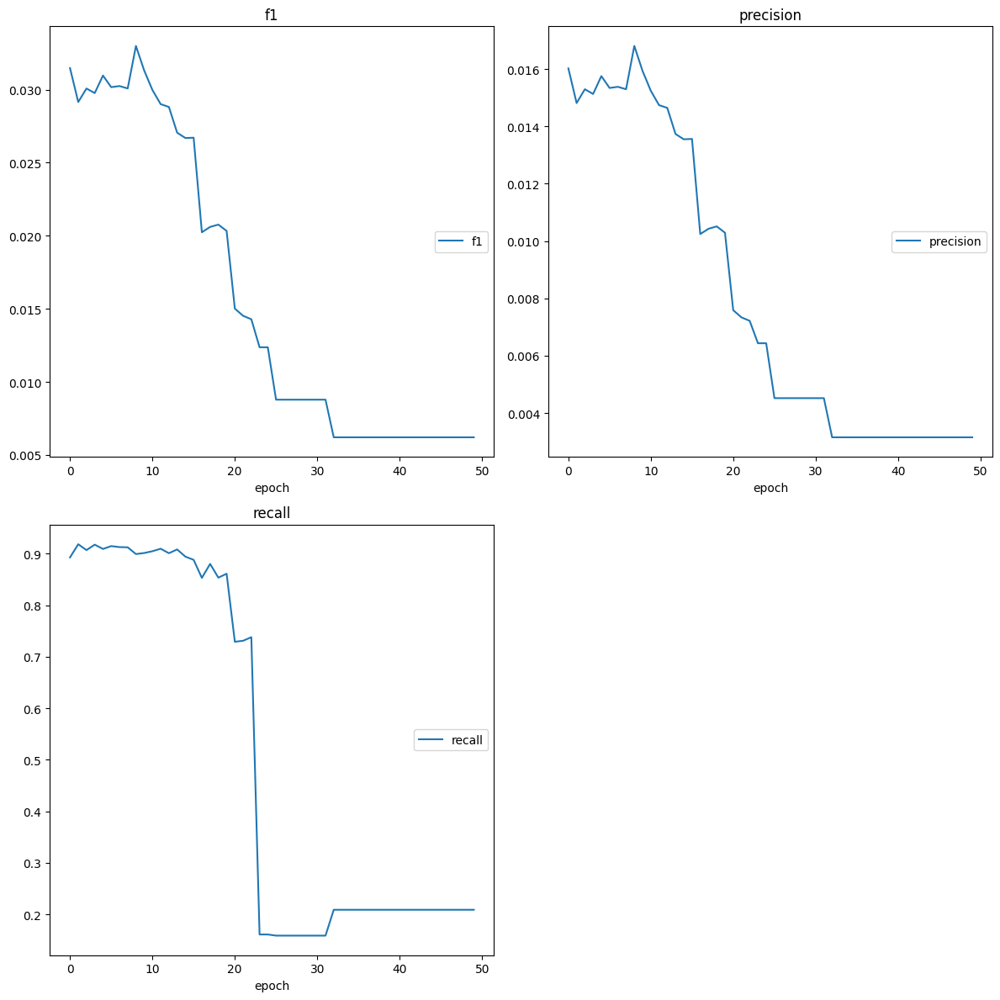

f1
	f1               	 (min:    0.006, max:    0.033, cur:    0.006)
precision
	precision        	 (min:    0.003, max:    0.017, cur:    0.003)
recall
	recall           	 (min:    0.158, max:    0.918, cur:    0.209)


(<lightgbm.basic.Booster at 0x75b9eccd7890>,
 [0.0160207885553741,
  0.014810816357029896,
  0.01529273769853392,
  0.015127675391189737,
  0.01575048396680275,
  0.015337309501062064,
  0.015377948022535684,
  0.015293135823075317,
  0.016804029659034814,
  0.0159307524389916,
  0.01523989675447506,
  0.014738375350140056,
  0.014641755751957778,
  0.013732144761522392,
  0.013547007024917191,
  0.013559143077361658,
  0.010241611027996726,
  0.010425437806136658,
  0.01050928567171042,
  0.010287814244309976,
  0.007585678883001229,
  0.007334583288807718,
  0.007213953557554098,
  0.006432541352051549,
  0.006432541352051549,
  0.0045172886807625,
  0.0045172886807625,
  0.0045172886807625,
  0.0045172886807625,
  0.0045172886807625,
  0.0045172886807625,
  0.0045172886807625,
  0.003151359219448627,
  0.003151359219448627,
  0.003151359219448627,
  0.003151359219448627,
  0.003151359219448627,
  0.003151359219448627,
  0.003151359219448627,
  0.003151359219448627,
  0.0031513592194

In [10]:
# New params
params = {
    "objective": "binary",
    "learning_rate": 0.02,
    "scale_pos_weight": 403,
    "verbosity": -1,
}

# Retrain the model
train_model(train, val, params, n_rounds=100)

So adding a weight to address the imbalance improved recal but our precision is still taking a hit. Since this is a ranking problem, let change our objective function to `lambdarank`so that we can train the model to rank correct template above incorrect ones to optimise rank based metrics.

In [ ]:
params = {
    "objective": "lambdarank",
    "metric": "ndcg",
    "label_gain": [0, 1],
    "learning_rate": 0.02,
    "num_leaves": 31,
    "verbosity": -1,
    "scale_pos_weight": 403,
}

We will also plot different metrics more suitable to ranking. We want to see how accurattely our top prediction is correct, also whether the correct template is in the top3. We will call this `accuracy@1` and `recall@3`. We'll also include the Mean Reciprocal Rank to evalulate how high up the correct answer is in the ranked list.

In [27]:
def compute_ranking_metrics(df, k=3):
    # Group
    grouped = df.groupby("clean_row_id")

    # Get top 1 and calculate accuracy
    top1 = grouped.apply(lambda g: g.loc[g["score"].idxmax()]).reset_index(drop=True)
    acc1 = (top1["label"] == 1).mean()

    # Same with recall
    topk = grouped.apply(lambda g: g.nlargest(k, "score")).reset_index(drop=True)
    recall_k = topk.groupby("clean_row_id")["label"].max().mean()

    # MMR
    def reciprocal_rank(g):
        sorted_g = g.sort_values("score", ascending=False).reset_index()
        match = sorted_g[sorted_g["label"] == 1]
        return 1.0 / (match.index[0] + 1) if not match.empty else 0.0

    mrr = grouped.apply(reciprocal_rank).mean()
    return acc1, recall_k, mrr

We'll write a new loop to incoporate these new metrics

In [12]:
def train_model(train_ids, val_ids, parameters, n_rounds=50):
    liveloss = PlotLosses()

    # Load validation set once
    val_df = pd.concat(list(feature_matrix_batch_loader(val_ids, batch_size=1024)))
    X_val = val_df.drop(
        columns=["label", "clean_row_id", "investor", "firm", "template_id"]
    )
    y_val = val_df["label"]

    model = None
    for batch in feature_matrix_batch_loader(train_ids, batch_size=1024):
        y = batch["label"]
        X = batch.drop(
            columns=["label", "clean_row_id", "investor", "firm", "template_id"]
        )

        # Group sizes for lambdarank
        group_sizes = batch.groupby("clean_row_id").size().tolist()
        lgb_train = lgb.Dataset(X, label=y, group=group_sizes, free_raw_data=False)

        # Train model
        model = lgb.train(
            params=parameters,
            train_set=lgb_train,
            num_boost_round=n_rounds,
            init_model=model,
        )

        # Predict on full validation set
        val_df["score"] = model.predict(X_val)

        acc1, recall3, mrr = compute_ranking_metrics(val_df, k=3)
        logs = {"accuracy@1": acc1, "recall@3": recall3, "MRR": mrr}
        liveloss.update(logs)
        liveloss.send()

    return model

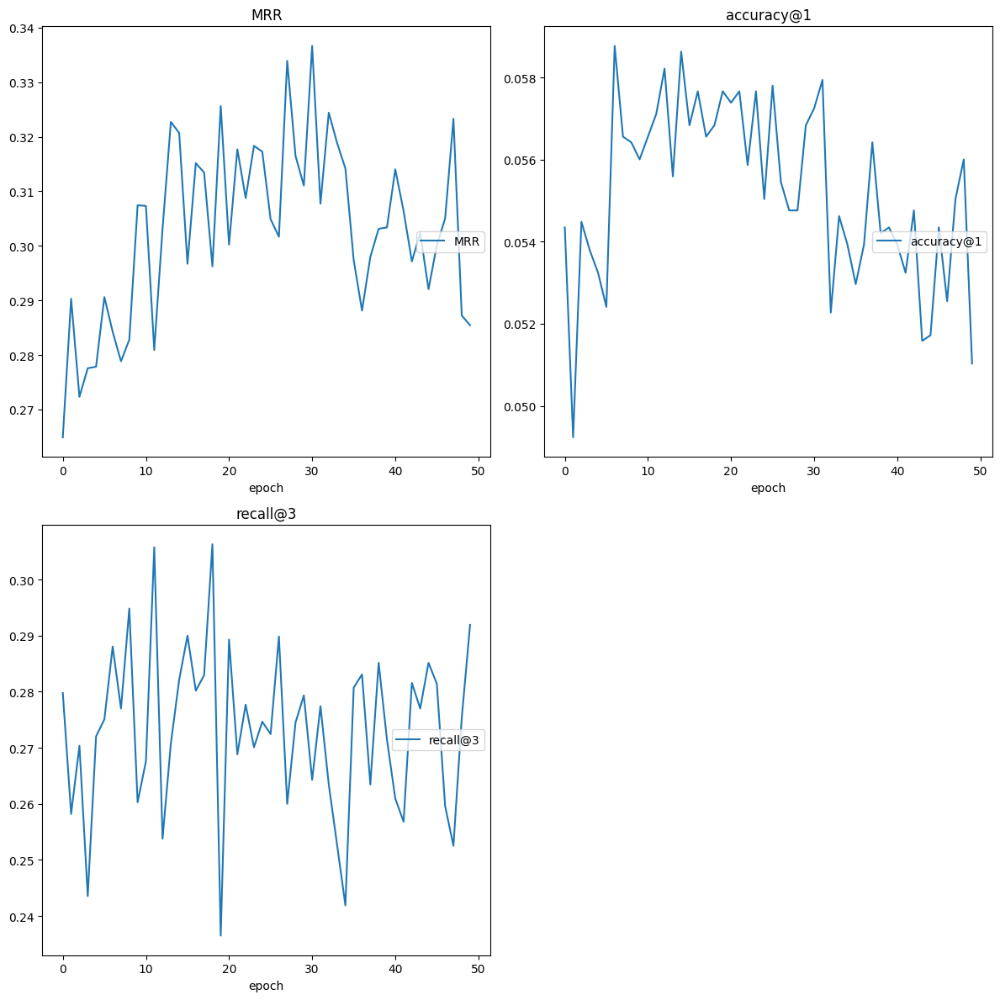

MRR
	MRR              	 (min:    0.265, max:    0.337, cur:    0.285)
accuracy@1
	accuracy@1       	 (min:    0.049, max:    0.059, cur:    0.051)
recall@3
	recall@3         	 (min:    0.236, max:    0.306, cur:    0.292)


In [20]:
# Retrain the model
train_model(train, val, params, n_rounds=100)

So this is at least stable, although our metrics arent much better. We aren't, however, seeing the complete collapse of results we saw in previous iterations, probably due to overfitting. I think its time to start investigating new features. What we are missing is some indication of the templates coverage in the dataset. 

So back to feature engineering...

First thing to note is we are calculating the coverage percentage wrong. Instead of checking coverage inside the clean data, we are checking the coverage within the unique candidates, which will always 1/404 since the candidate list is a set. So first thing to do is fix that.

```python
# Count how many times each token_seq appears
support_series = clean_df["token_seq_str"].value_counts()
coverage_series = support_series / total_templates
...
"support_count": support_series.get(tpl_str, 0),
"coverage_pct": coverage_series.get(tpl_str, 0.0),
```

Now that our support and coverage metrics are being correctly calculated. We should include some more statistics flags. To do this we will compute the template coverage and support within the firm group.

```python
"template_firm_support_count": template_meta.get("support_count", 0),
"template_firm_coverage_pct": template_meta.get("coverage_pct", 0.0),
"template_is_top_template": template_meta.get("is_top_template", False),
```

Finally, we will detect clashes between template and investor name structure.

```python
def infer_token_clash_flags(clean_row, template_tokens):
    """
    Helper function to detect token and name clashes.
    """
    flags = []

    if clean_row["has_middle_name"]:
        if any(tok.startswith("m_") or "middle" in tok for tok in template_tokens):
            flags.append("middle")

    if clean_row["has_multiple_last_names"]:
        if any(tok.startswith("l_") or "last" in tok for tok in template_tokens):
            flags.append("last")

    if clean_row["has_multiple_first_names"]:
        if any(tok.startswith("f_") or "first_original_1" in tok for tok in template_tokens):
            flags.append("first")

    if clean_row["has_nfkd_normalized"]:
        if any("nfkd" in tok for tok in template_tokens):
            flags.append("nfkd")

    if clean_row["has_nickname"]:
        if any("nickname" in tok for tok in template_tokens):
            flags.append("nickname")

    return bool(flags)
```

This will allow LightGBM to automatically weigh against clashing template structures. Lets re-generate our feature matrix and candidate list so we can retrain.

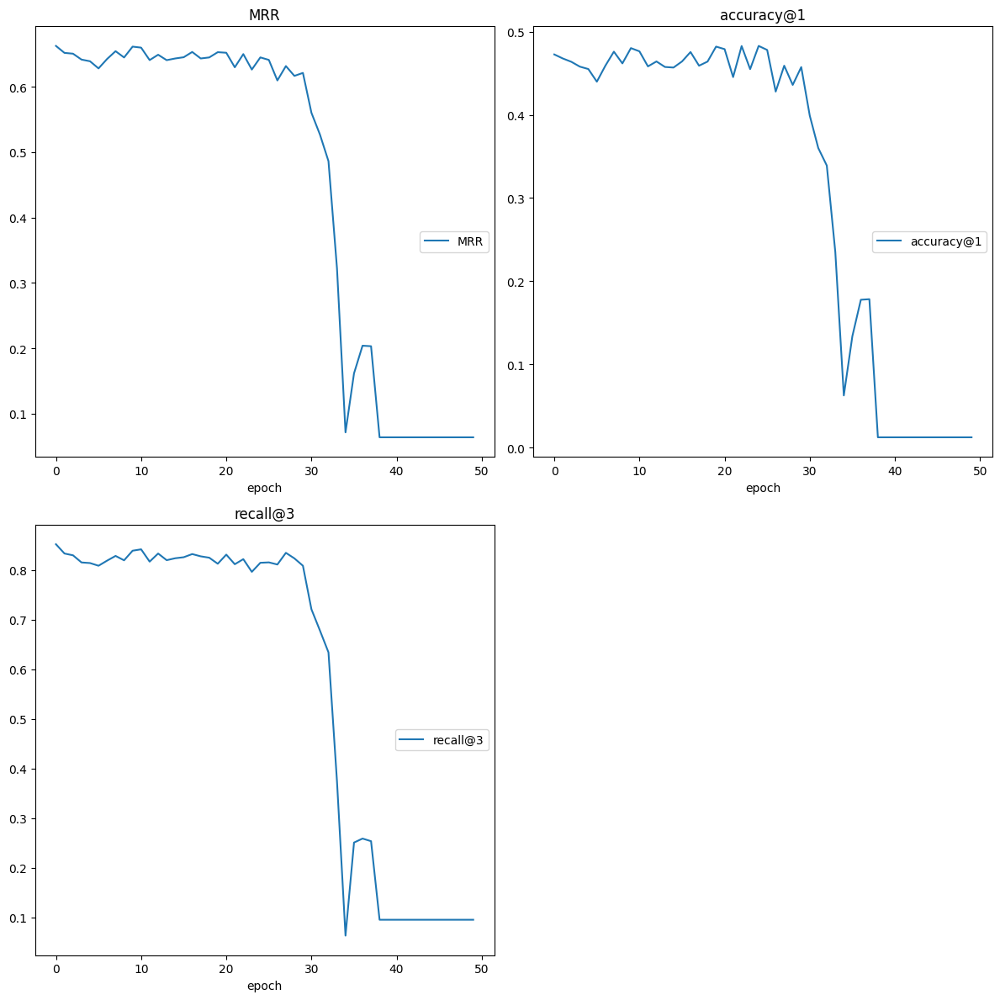

MRR
	MRR              	 (min:    0.064, max:    0.662, cur:    0.064)
accuracy@1
	accuracy@1       	 (min:    0.012, max:    0.483, cur:    0.012)
recall@3
	recall@3         	 (min:    0.064, max:    0.852, cur:    0.096)


In [13]:
# Retrain the model
train_model(train, val, params, n_rounds=100)

We were doing so well! Then suddenly the model completely collapsed and did not recover. I think the next thing to do is investigate learnig rate schedulers (we will apply an decay on the learning rate so that our steps are smaller for each epoch) along with a smaller batch size for smaller more controlled learning. Since LightGBM doesn't support true gradient clipping like `pytorch`, we will include gradient stability parameters (`max_depth`, `max_delta_step`, `min_split_gain`, etc.) to control this. 

It would also be valuable to investigate training loss and nan/inf score detection to be extra sure that our model is not encountering some sort of strange behaviour.

In [14]:
params = {
    "objective": "lambdarank",
    "metric": "ndcg",
    "label_gain": [0, 1],
    "learning_rate": 0.02,  # will decay over time via callback
    "num_leaves": 31,  # standard for small-medium trees
    "max_depth": 6,  # cap depth to prevent deep overfit splits
    "min_split_gain": 1e-3,  # avoid meaningless splits
    "min_child_weight": 1e-2,  # require minimum weight in children
    "max_delta_step": 1.0,  # caps weight updates for stability
    "scale_pos_weight": 403,
    "verbosity": -1,
    "boosting_type": "gbdt",
    "force_row_wise": True,  # improves stability in small-batch mode
}

In [18]:
def train_model(train_ids, val_ids, parameters, n_rounds=50):
    liveloss = PlotLosses()

    # Load validation set once
    val_df = pd.concat(list(feature_matrix_batch_loader(val_ids, batch_size=1024)))
    X_val = val_df.drop(
        columns=["label", "clean_row_id", "investor", "firm", "template_id"]
    )
    y_val = val_df["label"]

    model = None

    # Learning rate scheduler call back
    def lr_decay(current_round):
        return parameters["learning_rate"] * (0.95**current_round)

    for batch in feature_matrix_batch_loader(train_ids, batch_size=512):
        y = batch["label"]
        X = batch.drop(
            columns=["label", "clean_row_id", "investor", "firm", "template_id"]
        )

        # Group sizes for lambdarank
        group_sizes = batch.groupby("clean_row_id").size().tolist()
        lgb_train = lgb.Dataset(X, label=y, group=group_sizes, free_raw_data=False)

        # Train model
        model = lgb.train(
            params=parameters,
            train_set=lgb_train,
            num_boost_round=n_rounds,
            init_model=model,
            valid_sets=[lgb_train],
            valid_names=["train"],
            callbacks=[
                lgb.reset_parameter(learning_rate=lr_decay),
                lgb.log_evaluation(period=1),
            ],
        )

        # Predict on validation
        preds = model.predict(X_val)
        if np.isnan(preds).any() or np.isinf(preds).any():
            raise RuntimeError("Model produced NaN or Inf scores!")

        val_df["score"] = preds
        acc1, recall3, mrr = compute_ranking_metrics(val_df, k=3)
        liveloss.update(
            {
                "accuracy@1": acc1,
                "recall@3": recall3,
                "MRR": mrr,
            }
        )
        liveloss.send()

    return model

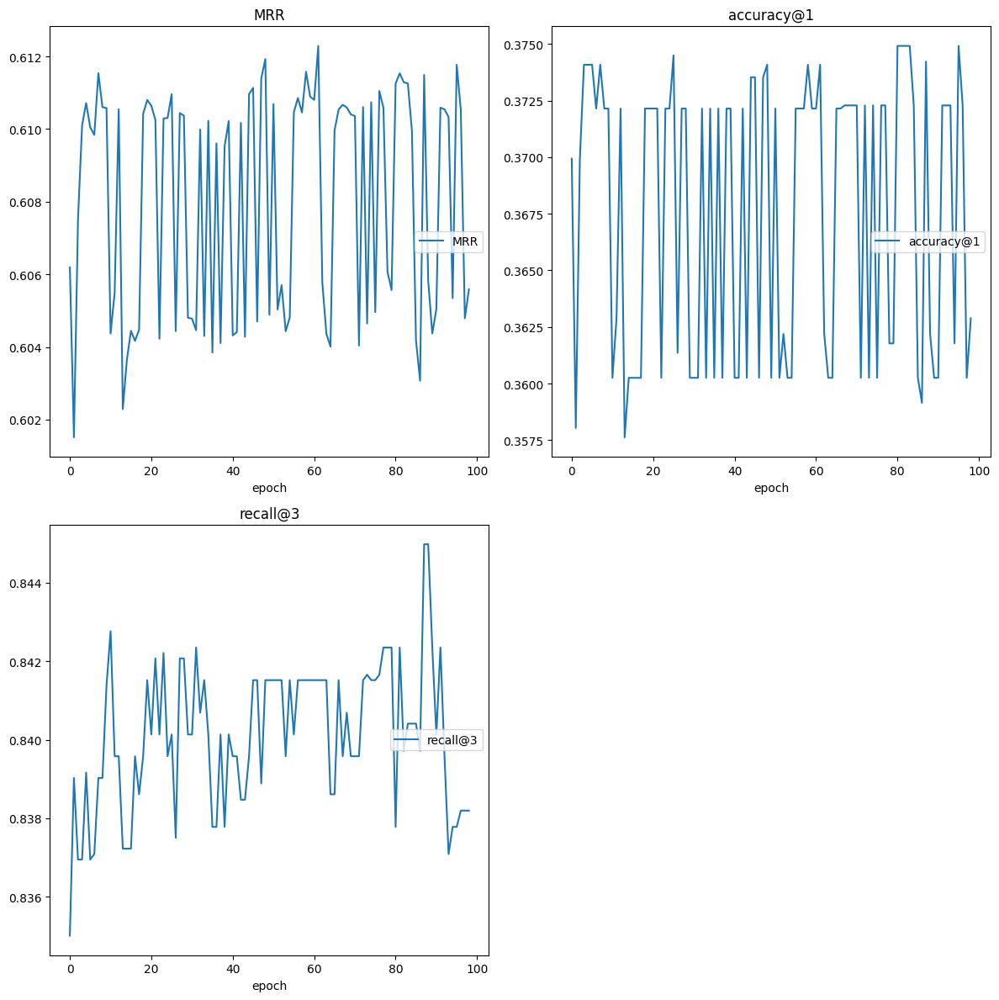

MRR
	MRR              	 (min:    0.602, max:    0.612, cur:    0.606)
accuracy@1
	accuracy@1       	 (min:    0.358, max:    0.375, cur:    0.363)
recall@3
	recall@3         	 (min:    0.835, max:    0.845, cur:    0.838)


In [19]:
# Retrain the model
train_model(train, val, params, n_rounds=100)

Training is now stable. But we are not seeing any meaningful improvements in training. It's time to really consider pruning our candidate templates.

Templates that use `_nfkd_` or `_translit_` are, in hindsight, not meaninful tokens since they should be part of standard normalisation. Looking through our candidate template, these normalised tokens are low coverage and simply duplicates of the `_original_` templates which have higher coverage. We should begin by investigating how many of these exist in the candidate list, entries like `_nickname_` pose a different challenge as they are not part of standard normalisation but we will deal with this when we come to it.

In [26]:
# Parse tokens, ids and load support
token_lists = candidate_templates["template"].apply(json.loads).tolist()
supports = candidate_templates["support_count"].tolist()
ids = candidate_templates["template_id"].tolist()


# Define normalization logic
def normalize_token(token):
    return re.sub(r"_(translit|nfkd|nfkd_translit|nickname)", "_original", token)


# Create original and normalized mappings with support
original_map = {}
normalized_map = defaultdict(lambda: [0, []])

for tokens, support, id in zip(token_lists, supports, ids):
    # Tuple for hash and normalise
    tpl = tuple(tokens)
    norm_tpl = tuple(normalize_token(tok) for tok in tokens)

    # Build original for tracing and add support
    original_map[tpl] = (support, id)
    normalized_map[norm_tpl][0] += support
    normalized_map[norm_tpl][1].append(id)

# Build sets
original_set = set(original_map.keys())
normalized_set = set(normalized_map.keys())

# Identify synthetic templates
synthetic_templates = normalized_set - original_set

# Print results with support
print(f"Original unique templates: {len(original_set)}")
print(f"Normalized unique templates: {len(normalized_set)}")
print(f"Synthetic templates introduced by normalization: {len(synthetic_templates)}")
print("\nSynthetic Templates with Aggregated Support:")

for tpl in synthetic_templates:
    print(f"Synthetic: {tpl} -> Support: {normalized_map[tpl][0]}")

Original unique templates: 404
Normalized unique templates: 303
Synthetic templates introduced by normalization: 8

Synthetic Templates with Aggregated Support:
Synthetic: ('last_original_0', '_', 'middle_original_0') -> Support: 1
Synthetic: ('first_original_0', 'middle_original_0', 'l_0', 'middle_original_0') -> Support: 1
Synthetic: ('f_0', '-', 'm_0', '.', 'last_original_0') -> Support: 1
Synthetic: ('f_0', 'last_original_0', '-', 'last_original_1', '-', 'last_original_2', '-', 'last_original_3', '-', 'last_original_4') -> Support: 1
Synthetic: ('first_original_0', 'm_0', '.', 'middle_original_1') -> Support: 1
Synthetic: ('first_original_0', 'last_original_0', 'l_1') -> Support: 1
Synthetic: ('f_0', 'middle_original_0', 'last_original_0', 'last_original_1') -> Support: 1
Synthetic: ('first_original_0', 'middle_original_0', '.', 'middle_original_1') -> Support: 1


We now have a much smaller candidate template list. We have introduced some synthetic templates which did exist in the previous candidate list, but these are low support so we can ditch these. Later on, if we are still struggling we can go through and ditch low support templates but we should be careful about this as alot of the templates are low coverage.

Lets prune candidate template list.

In [27]:
# Build clean rows
clean_rows = []

# Iterate through normalised map
for norm_tpl, (total_support, original_ids) in normalized_map.items():
    # Skip syntethics
    if norm_tpl in synthetic_templates:
        continue

    # Get the original ID and row to merge into
    rep_id = original_map[norm_tpl][1]
    rep_row = candidate_templates[candidate_templates["template_id"] == rep_id]

    # Favour original (already normalised) row stats as they have better rule definitions
    # "NFKD" or "TRANSLIT" did not appear in mined rules
    clean_rows.append(
        {
            "template_id": rep_id,
            "template": json.dumps(list(norm_tpl)),
            "support_count": int(total_support),
            "coverage_pct": float(total_support / lp_df.shape[0]),
            "in_mined_rules": bool(rep_row["in_mined_rules"].iloc[0]),
            "max_rule_confidence": float(rep_row["max_rule_confidence"].iloc[0]),
            "avg_rule_confidence": float(rep_row["avg_rule_confidence"].iloc[0]),
            "uses_middle_name": bool(rep_row["uses_middle_name"].iloc[0]),
            "uses_multiple_firsts": bool(rep_row["uses_multiple_firsts"].iloc[0]),
            "uses_multiple_middles": bool(rep_row["uses_multiple_middles"].iloc[0]),
            "uses_multiple_lasts": bool(rep_row["uses_multiple_lasts"].iloc[0]),
        }
    )

# Back to pandas frame
candidate_templates_clean = pd.DataFrame(clean_rows)
candidate_templates_clean

,template_id,template,support_count,coverage_pct,in_mined_rules,max_rule_confidence,avg_rule_confidence,uses_middle_name,uses_multiple_firsts,uses_multiple_middles,uses_multiple_lasts
0,1,"[""f_0"", ""m_0"", ""last_original_0"", ""last_origin...",2,0.000028,True,0.932963,0.473679,False,False,False,True
1,2,"[""first_original_0"", ""."", ""l_0"", ""."", ""last_or...",9,0.000124,True,0.968551,0.679765,False,False,False,False
2,3,"[""first_original_0"", ""."", ""m_0"", ""f_0""]",1,0.000014,True,0.707134,0.707134,False,False,False,False
3,4,"[""f_1"", ""last_original_0""]",1,0.000014,False,0.000000,0.000000,False,True,False,False
4,5,"[""l_0"", ""."", ""first_original_0""]",6,0.000083,False,0.000000,0.000000,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...
290,400,"[""m_0"", ""l_0""]",2,0.000028,False,0.000000,0.000000,False,False,False,False
291,401,"[""first_original_0"", ""last_original_0"", ""last_...",1,0.000014,True,0.734652,0.374523,False,False,False,True
292,402,"[""first_original_0"", ""."", ""middle_original_0"",...",1,0.000014,True,0.968551,0.677307,True,False,True,True
293,403,"[""f_0"", ""."", ""middle_original_0"", ""-"", ""last_o...",1,0.000014,True,0.968551,0.721696,True,False,False,False


Now we need to clean and prune the LP data. 

In [28]:
# Helper to normalise template
def normalize_template(tokens):
    return tuple(normalize_token(tok) for tok in tokens)


# Load and Normalize
lp_df["normalized_token_seq"] = lp_df["token_seq"].apply(normalize_template)

# Get Valid Normalized Templates
valid_templates = set(
    candidate_templates_clean["template"].apply(json.loads).apply(tuple)
)

# Filter
filtered_lp_clean = lp_df[lp_df["normalized_token_seq"].isin(valid_templates)].copy()

# Overwrite original token_seq with normalized version
filtered_lp_clean["token_seq"] = filtered_lp_clean["normalized_token_seq"].apply(list)

# Cleanup
filtered_lp_clean.drop(columns=["normalized_token_seq"], inplace=True)
filtered_lp_clean

,id,investor,firm_type,title,firm,alternative_name,role,job_title,asset_class,email,...,firm_is_multi_domain,has_german_char,has_nfkd_normalized,has_nickname,has_multiple_first_names,has_middle_name,has_multiple_middle_names,has_multiple_last_names,token_seq,time_stamp
0,155952,luigi mantrino,wealth manager,mr,alba investment partners,None,investment team,chief investment officer,gen,luigi@albainvestments.ch,...,False,False,False,False,False,False,False,False,[first_original_0],2025-07-01 22:00:10.655739
1,155920,jeff sears,wealth manager,mr,fondren oaks capital management,None,investment team,founder & principal,gen,jsears@fondrenoakscapital.com,...,False,False,False,False,False,False,False,False,"[f_0, last_original_0]",2025-07-01 22:00:10.655739
2,155919,jason mills,wealth manager,mr,fondren oaks capital management,None,investment team,principal,gen,jmills@fondrenoakscapital.com,...,False,False,False,False,False,False,False,False,"[f_0, last_original_0]",2025-07-01 22:00:10.655739
3,155916,patrick cicchetti,wealth manager,mr,ryse capital management,None,investment team,founder,gen,patrick@rysecapitalmanagement.com,...,False,False,False,True,False,False,False,False,[first_original_0],2025-07-01 22:00:10.655739
4,155915,leslie smith,wealth manager,ms,coronado financial group,None,investment team,founder & principal,hf,lsmith@coronadoadvisors.com,...,False,False,False,False,False,False,False,False,"[f_0, last_original_0]",2025-07-01 22:00:10.655739
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72305,5,george archer,fund manager,mr,3i,None,"finance/accountancy,investment team","partner, banking team","pe,inf,nr",george.archer@3i.com,...,False,False,False,False,False,False,False,False,"[first_original_0, ., last_original_0]",2025-07-01 22:00:10.655739
72306,4,michael specht,fund manager,mr,3i,None,investment team,"partner, german private equity team","pe,inf,nr",michael.specht@3i.com,...,False,False,False,True,False,False,False,False,"[first_original_0, ., last_original_0]",2025-07-01 22:00:10.655739
72307,3,david stephens,fund manager,mr,3i,None,investment team,partner & co-head of uk private equity team,pe,david.stephens@3i.com,...,False,False,False,True,False,False,False,False,"[first_original_0, ., last_original_0]",2025-07-01 22:00:10.655739
72308,2,gaurav bhurat,fund manager,mr,3i,None,investment team,director,"pe,inf,nr",gaurav.bhurat@3i.com,...,False,False,False,False,False,False,False,False,"[first_original_0, ., last_original_0]",2025-07-01 22:00:10.655739


Finally we have to rebuild our firm template map to use the new template ids.

In [29]:
# Build the map: original ID -> normalized canonical ID
old_to_new_template_id = {}

# Go through the original map to map overwritten ids with normalised ones
for orig_templ, (_, orig_id) in original_map.items():
    normalized_tpl = tuple(normalize_token(tok) for tok in orig_templ)

    # Only include normalised and non synethic templates
    if normalized_tpl in normalized_map and normalized_tpl not in synthetic_templates:
        normalised_ids = normalized_map[normalized_tpl][1]
        # Create an entry for each id in the tuple
        for id in normalised_ids:
            old_to_new_template_id[id] = orig_id


firm_template_map["template_ids_list"] = firm_template_map["template_ids"].apply(
    lambda s: [int(x) for x in json.loads(s)] if isinstance(s, str) else s
)

# Rewrite template ids with new ones
firm_template_map["template_ids"] = (
    firm_template_map["template_ids_list"]
    .apply(
        lambda ids: sorted(
            {
                old_to_new_template_id[tid]
                for tid in ids
                if tid in old_to_new_template_id
            }
        )
    )
    .apply(json.dumps)
)
firm_template_map = firm_template_map.drop(columns="template_ids_list")
firm_template_map

,firm,template_ids,num_templates,num_investors,diversity_ratio,is_single_template
0,0704 capital,[100],1,1,1.000000,True
1,1 north wealth services,"[100, 379]",2,5,0.400000,False
2,10 branch,[379],1,1,1.000000,True
3,10 east,[100],1,1,1.000000,True
4,1010 capital,[379],1,7,0.142857,True
...,...,...,...,...,...,...
14469,ålands mutual insurance company,[351],1,1,1.000000,True
14470,ícone investimentos,[377],1,1,1.000000,True
14471,íslenski lífeyrissjóðurinn,"[285, 360, 379]",3,4,0.750000,False
14472,österreichische beteiligungs,[377],1,1,1.000000,True


Ok now we can regen our features and retrain (I have dropped the table in the background).

In [7]:
candidate_templates.columns

Index(['template_id', 'template', 'support_count', 'coverage_pct',
       'in_mined_rules', 'max_rule_confidence', 'avg_rule_confidence',
       'uses_middle_name', 'uses_multiple_firsts', 'uses_multiple_middles',
       'uses_multiple_lasts'],
      dtype='object')

In [10]:
# Regen
init_db()
feature_matrix = build_feature_matrix(lp_df, candidate_templates, firm_template_map)

Tables created successfully.
0 features built out of 72110
294 upserted, 0 inserted into FEATURE_MATRIX
294 upserted, 0 inserted into FEATURE_MATRIX
294 upserted, 0 inserted into FEATURE_MATRIX
294 upserted, 0 inserted into FEATURE_MATRIX
294 upserted, 0 inserted into FEATURE_MATRIX
294 upserted, 0 inserted into FEATURE_MATRIX
294 upserted, 0 inserted into FEATURE_MATRIX
294 upserted, 0 inserted into FEATURE_MATRIX
294 upserted, 0 inserted into FEATURE_MATRIX
294 upserted, 0 inserted into FEATURE_MATRIX
294 upserted, 0 inserted into FEATURE_MATRIX
294 upserted, 0 inserted into FEATURE_MATRIX
294 upserted, 0 inserted into FEATURE_MATRIX
294 upserted, 0 inserted into FEATURE_MATRIX
294 upserted, 0 inserted into FEATURE_MATRIX
294 upserted, 0 inserted into FEATURE_MATRIX
294 upserted, 0 inserted into FEATURE_MATRIX
294 upserted, 0 inserted into FEATURE_MATRIX
294 upserted, 0 inserted into FEATURE_MATRIX
294 upserted, 0 inserted into FEATURE_MATRIX
294 upserted, 0 inserted into FEATURE_MAT

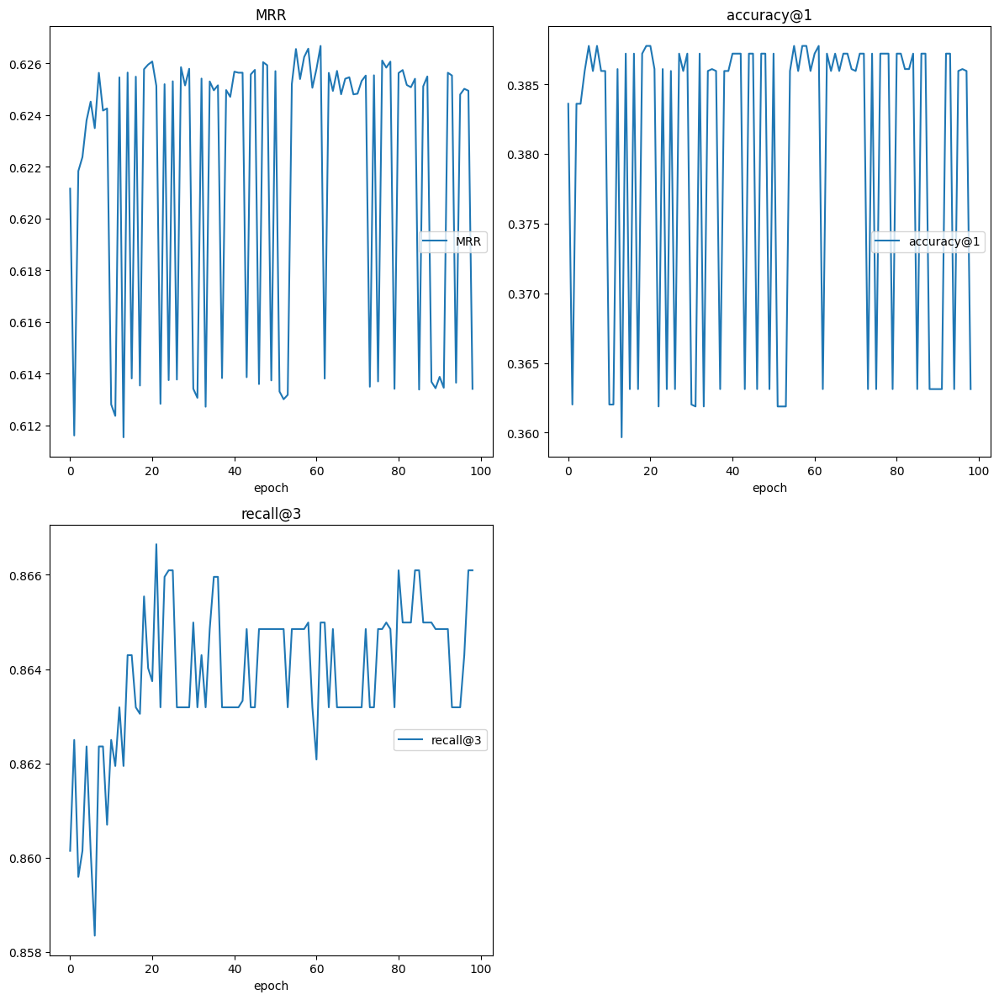

MRR
	MRR              	 (min:    0.612, max:    0.627, cur:    0.613)
accuracy@1
	accuracy@1       	 (min:    0.360, max:    0.388, cur:    0.363)
recall@3
	recall@3         	 (min:    0.858, max:    0.867, cur:    0.866)


In [173]:
# Retrain the model
train_model(train, val, params, n_rounds=100)

Seeing the same thing again. After more research, despite using `init_model=model` training the model in batches of data defeats the purpose gradient boosting - because training models like these is fundamentally different from models like neural networks or linear models.

Since tree models like `LightGBM` work by calculating the residuals of its current predictions and fits a tree to it. This requires the algorithm to have a global view of the data so it can fit a tree to the entire gradient or hessian. Lets try and tweak our split so we can fit our training set in ram, then we can retrain the model on the entire dataset (or subset) and see how it does.

In [28]:
params = {
    "objective": "lambdarank",
    "metric": ["ndcg"],
    "eval_at": [1, 3],
    "label_gain": [0, 1],
    "learning_rate": 0.1,
    "num_leaves": 31,
    "max_depth": 6,
    "min_split_gain": 1e-3,
    "min_child_weight": 1e-2,
    "max_delta_step": 1.0,
    "scale_pos_weight": 294,
    "verbosity": -1,
    "boosting_type": "gbdt",
    "force_row_wise": True,
}

In [ ]:
def train_model(
    train_ids,
    val_ids,
    parameters: dict,
    n_rounds: int = 100,
    lr_decay_gamma: float = 0.95,
):
    # Load validation set
    val_df = pd.concat(list(feature_matrix_batch_loader(val_ids, batch_size=1024)))
    X_val = val_df.drop(
        columns=["label", "clean_row_id", "investor", "firm", "template_id"]
    )
    y_val = val_df["label"]
    val_group_sizes = val_df.groupby("clean_row_id").size().tolist()
    lgb_val = lgb.Dataset(
        X_val, label=y_val, group=val_group_sizes, free_raw_data=False
    )

    # Load full training set
    train_df = pd.concat(list(feature_matrix_batch_loader(train_ids, batch_size=1024)))
    X_train = train_df.drop(
        columns=["label", "clean_row_id", "investor", "firm", "template_id"]
    )
    y_train = train_df["label"]
    train_group_sizes = train_df.groupby("clean_row_id").size().tolist()
    lgb_train = lgb.Dataset(
        X_train, label=y_train, group=train_group_sizes, free_raw_data=False
    )

    # Learning rate schedule
    def lr_decay(current_round):
        return parameters["learning_rate"] * (lr_decay_gamma**current_round)

    # Train model
    model = lgb.train(
        params=parameters,
        train_set=lgb_train,
        num_boost_round=n_rounds,
        valid_sets=[lgb_train, lgb_val],
        valid_names=["train", "val"],
        callbacks=[
            lgb.reset_parameter(learning_rate=lr_decay),
            lgb.early_stopping(stopping_rounds=20),
            lgb.log_evaluation(period=1),
        ],
    )

    # Predict and Evaluate
    preds = model.predict(X_val, num_iteration=model.best_iteration)
    val_df["score"] = preds

    acc1, recall3, mrr = compute_ranking_metrics(val_df, k=3)

    print("Evaluation Metrics (Validation Set):")
    print(f"Accuracy@1 : {acc1:.4f}")
    print(f"Recall@3   : {recall3:.4f}")
    print(f"MRR        : {mrr:.4f}")

    return model

In [11]:
model = train_model(train, val, params, n_rounds=100)

[1]	train's ndcg@1: 0.383882	train's ndcg@3: 0.670038	val's ndcg@1: 0.377205	val's ndcg@3: 0.664331
Training until validation scores don't improve for 20 rounds
[2]	train's ndcg@1: 0.386607	train's ndcg@3: 0.674788	val's ndcg@1: 0.381213	val's ndcg@3: 0.670745
[3]	train's ndcg@1: 0.386233	train's ndcg@3: 0.675629	val's ndcg@1: 0.380545	val's ndcg@3: 0.670931
[4]	train's ndcg@1: 0.386474	train's ndcg@3: 0.67537	val's ndcg@1: 0.379743	val's ndcg@3: 0.670368
[5]	train's ndcg@1: 0.386474	train's ndcg@3: 0.675344	val's ndcg@1: 0.379743	val's ndcg@3: 0.670368
[6]	train's ndcg@1: 0.375678	train's ndcg@3: 0.671419	val's ndcg@1: 0.374933	val's ndcg@3: 0.66868
[7]	train's ndcg@1: 0.375678	train's ndcg@3: 0.671419	val's ndcg@1: 0.374933	val's ndcg@3: 0.66868
[8]	train's ndcg@1: 0.386607	train's ndcg@3: 0.675424	val's ndcg@1: 0.381213	val's ndcg@3: 0.671103
[9]	train's ndcg@1: 0.386634	train's ndcg@3: 0.675462	val's ndcg@1: 0.381213	val's ndcg@3: 0.670998
[10]	train's ndcg@1: 0.375678	train's ndcg

/tmp/ipykernel_1811/2860974315.py:6: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  top1 = grouped.apply(lambda g: g.loc[g["score"].idxmax()]).reset_index(drop=True)
/tmp/ipykernel_1811/2860974315.py:10: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  topk = grouped.apply(lambda g: g.nlargest(k, "score")).reset_index(drop=True)
/tmp/ipykernel_1811/2860974315.py:19: FutureWarning: DataFrameGroupBy.apply operated on the g

\Evaluation Metrics (Validation Set):
Accuracy@1 : 0.3812
Recall@3   : 0.8645
MRR        : 0.6207


Ok we no longer have the helpful plot, but we can see how the model trains incrementally from the print out. Around round 25 we no longer get any meaninful gain and the model hits its early stopping quota. This happens very quickly but we give it 20 rounds to be sure its not gaining anything. This means our model learnt quickly and then plateaued which is usually a good sign of strong signal. 

Interpretting the results, it seems like we make a correct prediction in the top 1 of the ranking about 40% of the time, whereas we make a correct prediction in the top 3 about 87% of the time. 

So the model is strong, but not really strong enough for my liking. I am certain now that this is a problem of template diversity, less used templates are likely accounting for our error. Our results seem to line up with the EDA we did on template diversity that highlighted most cases where covered by just a few firms leaving the minority to low coverage email templates.

It's time to stratify by domain and see which ones perform badly, we can link this to template coverage and confirm whether or not my intuition is correct. This might even lead to more feature engineering but in reality I think its time to consider data augmentation or strong imputation policies.

In [ ]:
# Get domains for validation set
val_lp_df = lp_df[lp_df["id"].isin(val)].copy()
val_lp_df["domain"] = (
    val_lp_df["email"].str.extract(r"@([\w\.-]+\.\w+)$")[0].str.lower()
)

# Group by domain
domain_to_ids = val_lp_df.groupby("domain")["id"].apply(list).to_dict()

# Evaluate each domain
results = []
for domain, ids in domain_to_ids.items():
    print(f"Predicting on {domain} ids.")

    # Load feature matrix rows for this domain
    df = pd.concat(list(feature_matrix_batch_loader(ids, batch_size=1024)))

    if df.shape[0] < 1:  # Skip empty domains
        print(f"Skipping {domain} because batching return empty DF!")
        continue

    if "score" not in df.columns:
        # Apply model prediction
        X = df.drop(
            columns=["label", "clean_row_id", "investor", "firm", "template_id"]
        )
        df["score"] = model.predict(X, num_iteration=model.best_iteration)

    acc1, recall3, mrr = compute_ranking_metrics(df, k=3)

    results.append(
        {
            "domain": domain,
            "n_queries": df["clean_row_id"].nunique(),
            "accuracy@1": acc1,
            "recall@3": recall3,
            "MRR": mrr,
        }
    )

domain_metrics = pd.DataFrame(results).sort_values("MRR", ascending=False)

Lets look at the statistics of predictions. See how how our accuracy and other metrics distribute across domains.

MRR Stats count    4126.000000
mean        0.566672
std         0.313955
min         0.003448
25%         0.333333
50%         0.500000
75%         1.000000
max         1.000000
Name: MRR, dtype: float64
accuracy@1 Stats count    4126.000000
mean        0.316677
std         0.459278
min         0.000000
25%         0.000000
50%         0.000000
75%         1.000000
max         1.000000
Name: accuracy@1, dtype: float64
recall@3 Stats count    4126.000000
mean        0.834200
std         0.363424
min         0.000000
25%         1.000000
50%         1.000000
75%         1.000000
max         1.000000
Name: recall@3, dtype: float64


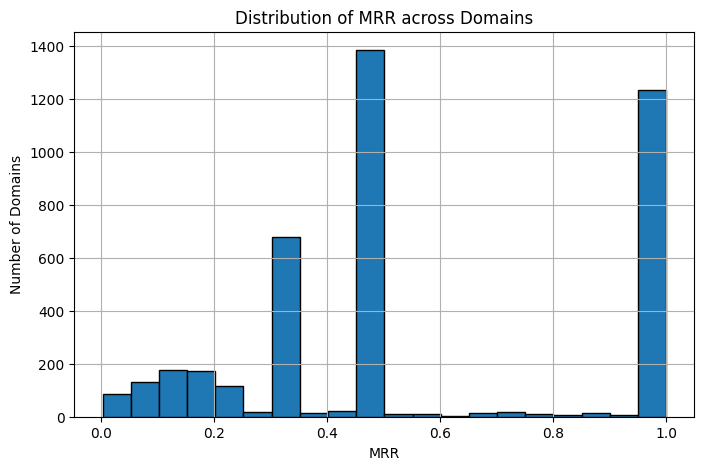

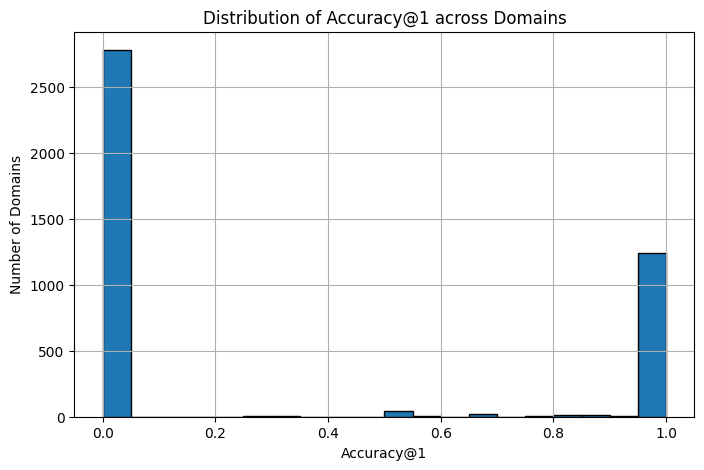

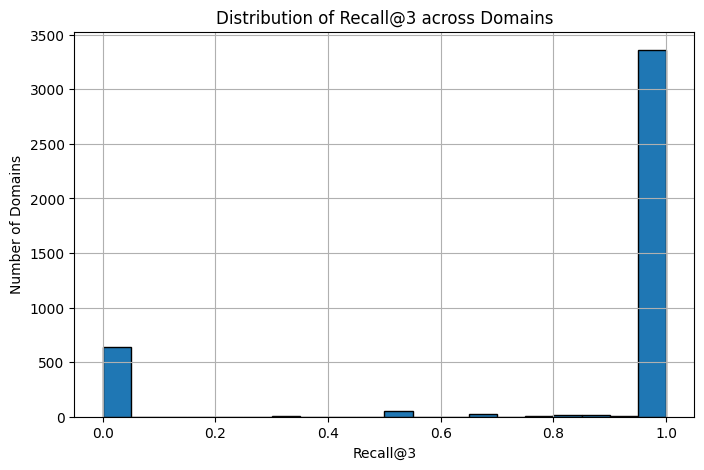

In [ ]:
# Check stats
print(f"MRR Stats {domain_metrics['MRR'].describe()}")
print(f"accuracy@1 Stats {domain_metrics['accuracy@1'].describe()}")
print(f"recall@3 Stats {domain_metrics['recall@3'].describe()}")
# Plot histogram
plt.figure(figsize=(8, 5))
plt.hist(domain_metrics["MRR"], bins=20, edgecolor="black")
plt.title("Distribution of MRR across Domains")
plt.xlabel("MRR")
plt.ylabel("Number of Domains")
plt.grid(True)
plt.show()
plt.figure(figsize=(8, 5))
plt.hist(domain_metrics["accuracy@1"], bins=20, edgecolor="black")
plt.title("Distribution of Accuracy@1 across Domains")
plt.xlabel("Accuracy@1")
plt.ylabel("Number of Domains")
plt.grid(True)
plt.show()
plt.figure(figsize=(8, 5))
plt.hist(domain_metrics["recall@3"], bins=20, edgecolor="black")
plt.title("Distribution of Recall@3 across Domains")
plt.xlabel("Recall@3")
plt.ylabel("Number of Domains")
plt.grid(True)
plt.show()

Were seeing some bimodal distributions across all metrics, some more severe than others. For accuracy were seeing themajority of cases not being ranked correctly at the top position. Whereas recall and MRR indicate that most cases are predicted within the top of the ranked list. Accuracy@1 on the other hand sees most cases are not predicted correctly in the top of the ranked list. This tells us for most domains, most cases are correctly ranked in the top 3. 

Let's investigate the poorly performing accuracy domains to see if there is trend in firm diversity.

In [16]:
# Map domain to firms
domain_to_firms = val_lp_df.groupby("domain")["firm"].unique().to_dict()

# Highlight low accuracy domains
low_acc_domains = domain_metrics[domain_metrics["accuracy@1"] < 0.2]["domain"]

# Collect associated firms
firms_from_low_acc = set()
for domain in low_acc_domains:
    firms_from_low_acc.update(domain_to_firms.get(domain, []))

subset_firm_stats = firm_template_map[
    firm_template_map["firm"].isin(firms_from_low_acc)
]
subset_firm_stats

,firm,template_ids,num_templates,num_investors,diversity_ratio,is_single_template
9,1607 capital partners,[4],1,3,0.333333,True
10,1650 wealth management,[54],1,1,1.000000,True
15,1834 investment advisors,"[1, 4]",2,8,0.250000,False
16,1858 wealth management,[105],1,2,0.500000,True
30,303 capital partners,"[4, 234]",2,5,0.400000,False
...,...,...,...,...,...,...
14432,zhuhai technology venture investment,[222],1,1,1.000000,True
14443,zlc wealth,"[4, 131]",2,6,0.333333,False
14445,zonsen industrial group,"[4, 156, 222]",3,4,0.750000,False
14447,zt wealth advisory,"[4, 105]",2,6,0.333333,False


Now lets investigate different fields in the firm template map

Num Templates Stats:
count    2785.000000
mean        1.535727
std         0.986383
min         1.000000
25%         1.000000
50%         1.000000
75%         2.000000
max        11.000000
Name: num_templates, dtype: float64

Num Investors Stats (from firm_template_map):
count    2785.000000
mean        9.628366
std        31.867330
min         1.000000
25%         2.000000
50%         5.000000
75%         9.000000
max      1344.000000
Name: num_investors, dtype: float64

Diversity Ratio Stats (from firm_template_map):
count    2785.000000
mean        0.396377
std         0.312849
min         0.008185
25%         0.153846
50%         0.307692
75%         0.500000
max         1.000000
Name: diversity_ratio, dtype: float64


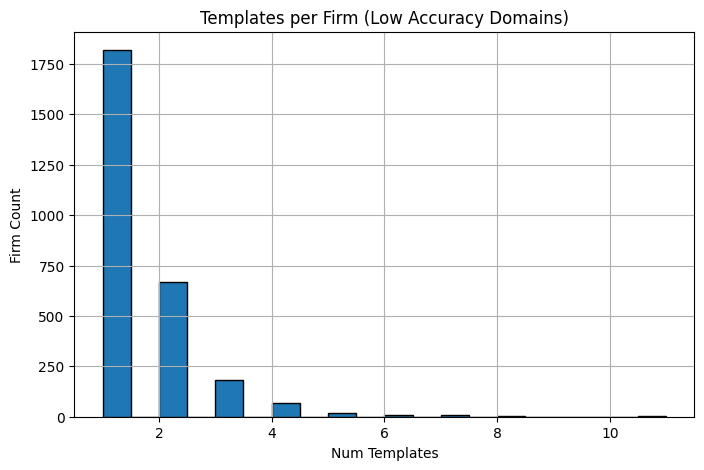

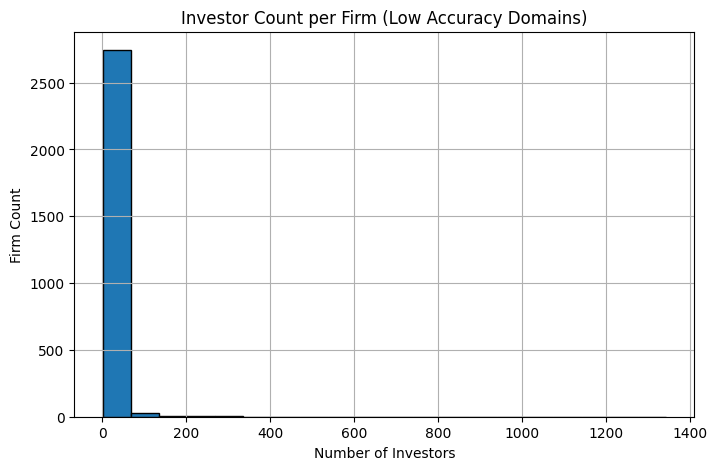

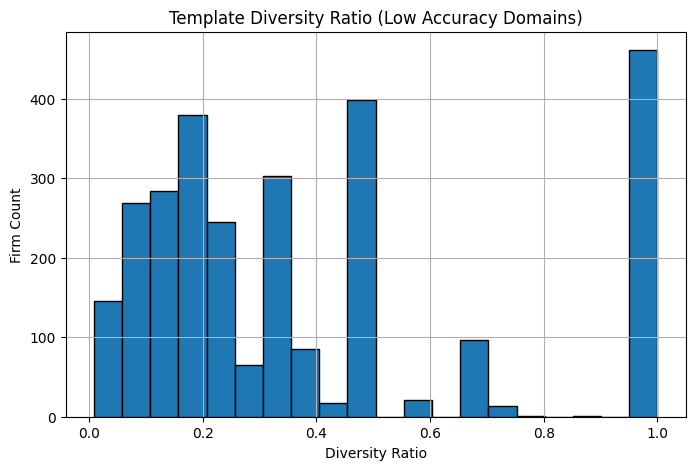

In [17]:
# Stats for poorly performing firms
print("Num Templates Stats:")
print(subset_firm_stats["num_templates"].describe())

print("\nNum Investors Stats (from firm_template_map):")
print(subset_firm_stats["num_investors"].describe())

print("\nDiversity Ratio Stats (from firm_template_map):")
print(subset_firm_stats["diversity_ratio"].describe())

# Plot
plt.figure(figsize=(8, 5))
plt.hist(subset_firm_stats["num_templates"], bins=20, edgecolor="black")
plt.title("Templates per Firm (Low Accuracy Domains)")
plt.xlabel("Num Templates")
plt.ylabel("Firm Count")
plt.grid(True)
plt.show()
plt.figure(figsize=(8, 5))
plt.hist(subset_firm_stats["num_investors"], bins=20, edgecolor="black")
plt.title("Investor Count per Firm (Low Accuracy Domains)")
plt.xlabel("Number of Investors")
plt.ylabel("Firm Count")
plt.grid(True)
plt.show()
plt.figure(figsize=(8, 5))
plt.hist(subset_firm_stats["diversity_ratio"], bins=20, edgecolor="black")
plt.title("Template Diversity Ratio (Low Accuracy Domains)")
plt.xlabel("Diversity Ratio")
plt.ylabel("Firm Count")
plt.grid(True)
plt.show()

This is insightful. Most of our poor performing domains are from low diversity but small investor count firms. The big takeway is that clearly the model struggles with firms/domains that do not have enough investors in them. Synthetic padding could resolve this, as part of an augmentation pipeline. We could take a look a low investor count firms and pad them with synthetic investors in such a way that the general distribution of structural features and template usuage stays the same.

Let's investigate the high template counts that still have low accuracy.

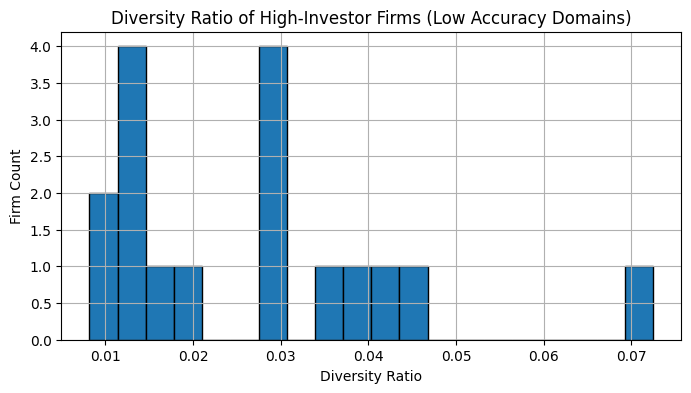

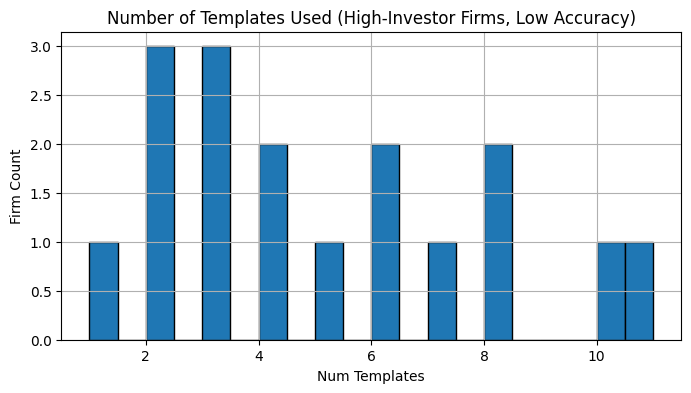

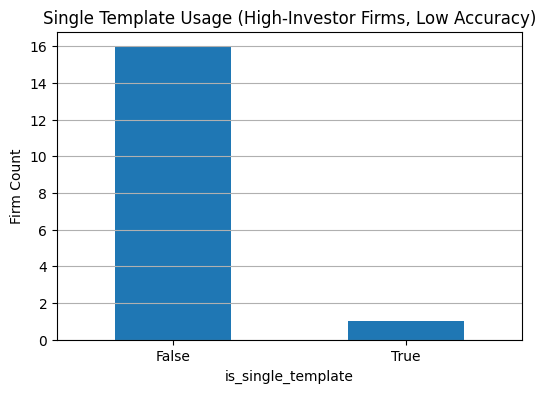

In [18]:
# Compute high-investor firm set
high_investor_firms = set(
    firm_template_map[firm_template_map["num_investors"] > 100]["firm"]
)

# Restrict domain-to-firm map to validation set only
val_lp_df["domain"] = (
    val_lp_df["email"].str.extract(r"@([\w\.-]+\.\w+)$")[0].str.lower()
)
val_domain_to_firms = val_lp_df.groupby("domain")["firm"].unique().to_dict()


# Filter domain_metrics (which was built from val set)
def is_high_investor_domain(domain):
    firms = val_domain_to_firms.get(domain, [])
    return any(f in high_investor_firms for f in firms)


# Get domains
target_domains = domain_metrics[
    (domain_metrics["accuracy@1"] < 0.2)
    & (domain_metrics["domain"].map(is_high_investor_domain))
]

# Map to firms
target_firms = {
    firm
    for d in target_domains["domain"]
    for firm in val_domain_to_firms.get(d, [])
    if firm in high_investor_firms
}

# Get stats
target_firm_stats = firm_template_map[firm_template_map["firm"].isin(target_firms)]

# Diversity Ratio
plt.figure(figsize=(8, 4))
plt.hist(target_firm_stats["diversity_ratio"], bins=20, edgecolor="black")
plt.title("Diversity Ratio of High-Investor Firms (Low Accuracy Domains)")
plt.xlabel("Diversity Ratio")
plt.ylabel("Firm Count")
plt.grid(True)
plt.show()

# Num Templates
plt.figure(figsize=(8, 4))
plt.hist(target_firm_stats["num_templates"], bins=20, edgecolor="black")
plt.title("Number of Templates Used (High-Investor Firms, Low Accuracy)")
plt.xlabel("Num Templates")
plt.ylabel("Firm Count")
plt.grid(True)
plt.show()

# Is Single Template
plt.figure(figsize=(6, 4))
target_firm_stats["is_single_template"].value_counts().plot(kind="bar")
plt.title("Single Template Usage (High-Investor Firms, Low Accuracy)")
plt.xticks(ticks=[0, 1], labels=["False", "True"], rotation=0)
plt.ylabel("Firm Count")
plt.grid(axis="y")
plt.show()

Eventhough template diversity is low, there are no single template firms in here. Maybe there is something in here to do with investor name structural features? 

In [19]:
# Filter to target firms
target_lp = lp_df[lp_df["firm"].isin(target_firms)].copy()

# Score validation set
val_df = pd.concat(list(feature_matrix_batch_loader(val, batch_size=1024)))
X = val_df.drop(columns=["label", "clean_row_id", "investor", "firm", "template_id"])
val_df["score"] = model.predict(X)


# Get top prediction per investor
top_preds = (
    val_df.sort_values("score", ascending=False)
    .groupby("clean_row_id")
    .first()
    .reset_index()[["clean_row_id", "label"]]
    .rename(columns={"label": "is_correct"})
)

# Merge into LP data
target_lp = target_lp.merge(
    top_preds, left_on="id", right_on="clean_row_id", how="inner"
)

In [20]:
# Flags to investigate
token_flags = [
    "is_shared_infra",
    "firm_is_multi_domain",
    "has_german_char",
    "has_nfkd_normalized",
    "has_nickname",
    "has_multiple_first_names",
    "has_middle_name",
    "has_multiple_middle_names",
    "has_multiple_last_names",
]

summary = []

# Calculate percentages for each flag
for flag in token_flags:
    total = target_lp[flag].sum()
    correct = target_lp[target_lp["is_correct"] == 1][flag].sum()
    wrong = target_lp[target_lp["is_correct"] == 0][flag].sum()
    pct_correct = correct / (target_lp["is_correct"] == 1).sum()
    pct_wrong = wrong / (target_lp["is_correct"] == 0).sum()

    summary.append(
        {
            "feature": flag,
            "total_occurrences": total,
            "percent_in_correct": round(pct_correct, 3),
            "percent_in_wrong": round(pct_wrong, 3),
        }
    )

pd.DataFrame(summary).sort_values("percent_in_wrong", ascending=False)

,feature,total_occurrences,percent_in_correct,percent_in_wrong
0,is_shared_infra,166,0.286,0.400
1,firm_is_multi_domain,148,0.714,0.349
4,has_nickname,111,0.143,0.268
8,has_multiple_last_names,7,0.143,0.015
3,has_nfkd_normalized,2,0.000,0.005
5,has_multiple_first_names,2,0.000,0.005
6,has_middle_name,1,0.000,0.002
2,has_german_char,0,0.000,0.000
7,has_multiple_middle_names,0,0.000,0.000


`is_shared_infra` and `firm_is_multi_domain` are very good signals. They help our model alot. The rarer cases also seem of structural features also seem to hurt our model in high investor firms.

This will take some more feature engineering to really figure out. For the time being the imediate plan of action is data augmentation by adding new investors to low investor count firms.

The first thing to do is pull low investor count firms (<4 since our statistics indicate that most low accuracy firms are less then four investors) and build a statistical profile.

In [21]:
len(firm_template_map["firm"].to_list())

14469

In [5]:
# Pull low investor firms
low_investor_firms = firm_template_map[firm_template_map["num_investors"] < 4][
    "firm"
].tolist()
low_investor_firms, len(low_investor_firms)

(['0704 capital',
  '10 branch',
  '10 east',
  '1200vc',
  '1248 holdings',
  '13th floor capital',
  '1618 investimentos',
  '1650 wealth management',
  '1776 wealth',
  '1788 capital',
  '180 degree capital',
  '1858 wealth management',
  '1888 management',
  '1st source bank',
  '205 capital',
  '21 north advisors',
  '2260 west',
  '2m companies',
  '2nd story wealth planners',
  '2w group',
  '3 dimensional wealth advisory',
  '305fo management',
  '32bj connecticut pension fund',
  '32bj school workers pension fund',
  '360 financial partners',
  '360 one wealth',
  '360 security technology',
  '3m employee retirement income plan',
  '3p equity partners',
  '3sisters sustainable management',
  '3t family office',
  '401k generation',
  '4100 group',
  '44 north capital',
  '44 wealth management',
  '46 peaks investment advisory group',
  '47 capital',
  '4l vision',
  '4s bay partners',
  '4square advisory services',
  '4thought financial group',
  '5am capital',
  '5t wealth ma

So the majority of firms are low investor count, this could indicate why the model struggles to generalise across domains. Ultimately the model is weighted to larger investor count firms. Let's take a global view of investor count statistics.

In [23]:
# Stats for all firm investor counts
firm_template_map["num_investors"].describe()

count    14469.000000
mean         5.172783
std         21.226636
min          1.000000
25%          1.000000
50%          2.000000
75%          5.000000
max       1344.000000
Name: num_investors, dtype: float64

Clearly the majority of our firms are low investor count. Let's bin our investor counts and see how they perfrom in validation.

/tmp/ipykernel_1811/2860974315.py:6: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  top1 = grouped.apply(lambda g: g.loc[g["score"].idxmax()]).reset_index(drop=True)
/tmp/ipykernel_1811/2860974315.py:10: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  topk = grouped.apply(lambda g: g.nlargest(k, "score")).reset_index(drop=True)
/tmp/ipykernel_1811/2860974315.py:19: FutureWarning: DataFrameGroupBy.apply operated on the g

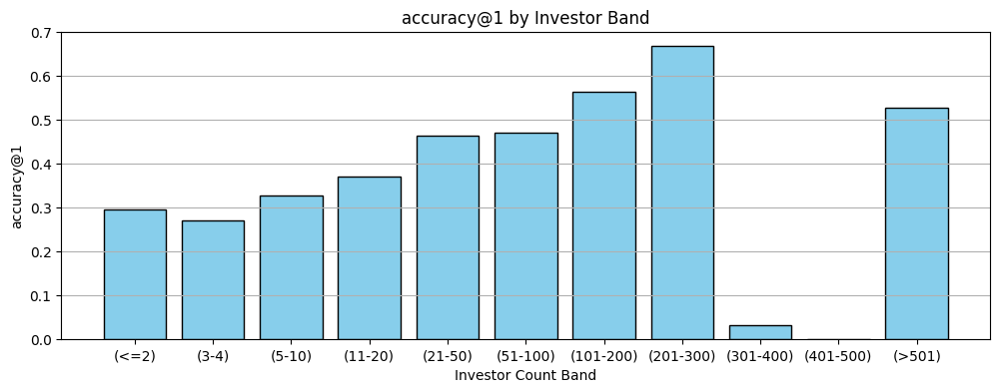

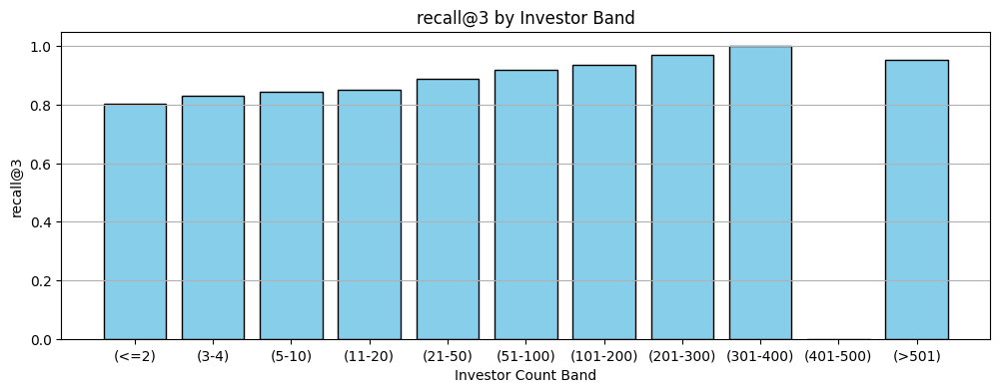

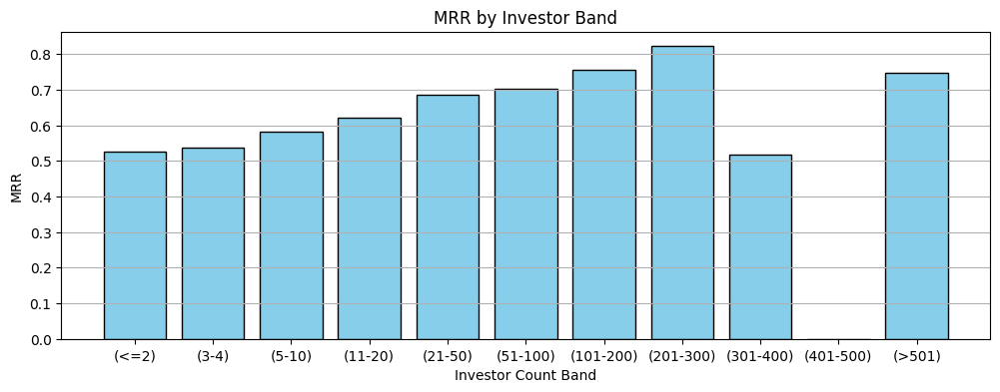

  investor_band  n_queries  accuracy@1  recall@3       MRR
8         (<=2)       1109    0.294860  0.803427  0.524865
4         (3-4)        909    0.269527  0.830583  0.535667
6        (5-10)       1749    0.325901  0.843339  0.580563
1       (11-20)       1076    0.369888  0.852230  0.622285
3       (21-50)       1021    0.463271  0.890304  0.684350
7      (51-100)        573    0.469459  0.917976  0.703156
0     (101-200)        307    0.563518  0.938111  0.755175
2     (201-300)        165    0.666667  0.969697  0.821688
5     (301-400)         31    0.032258  1.000000  0.516129
0     (401-500)          0    0.000000  0.000000  0.000000
9        (>501)        544    0.527574  0.952206  0.746536


In [35]:
def validatate_strat_investor_count(
    validation_df: pd.DataFrame, clean_df: pd.DataFrame
):
    validation_df = validation_df.copy()
    # Enrich validation predictions with firm level statistics
    val_lp = validation_df.merge(
        clean_df[["id", "firm"]], left_on="clean_row_id", right_on="id", how="left"
    )
    val_lp["firm"] = val_lp["firm_y"]
    val_lp = val_lp.drop(columns=["firm_x", "firm_y", "id"])
    val_lp = val_lp.merge(
        firm_template_map[["firm", "num_investors"]], on="firm", how="left"
    )

    # Helper to assing bands
    def assign_band(n):
        if n <= 2:
            return "(<=2)"
        if n <= 4:
            return "(3-4)"
        elif n <= 10:
            return "(5-10)"
        elif n <= 20:
            return "(11-20)"
        elif n <= 50:
            return "(21-50)"
        elif n <= 100:
            return "(51-100)"
        elif n <= 200:
            return "(101-200)"
        elif n <= 300:
            return "(201-300)"
        elif n <= 400:
            return "(301-400)"
        elif n <= 500:
            return "(401-500)"
        else:
            return "(>501)"

    # Apply bands to validation predictions
    val_lp["investor_band"] = val_lp["num_investors"].apply(assign_band)

    results = []
    # Validate
    for band, df in val_lp.groupby("investor_band"):
        acc1, recall3, mrr = compute_ranking_metrics(df, k=3)
        results.append(
            {
                "investor_band": band,
                "n_queries": df["clean_row_id"].nunique(),
                "accuracy@1": acc1,
                "recall@3": recall3,
                "MRR": mrr,
            }
        )

    results_df = pd.DataFrame(results).sort_values("investor_band")

    # Band ordering for proper sorting
    band_order = [
        "(<=2)",
        "(3-4)",
        "(5-10)",
        "(11-20)",
        "(21-50)",
        "(51-100)",
        "(101-200)",
        "(201-300)",
        "(301-400)",
        "(401-500)",
        "(>501)",
    ]

    # Ensure all bands exist in the DataFrame, even if zero
    for band in band_order:
        if band not in results_df["investor_band"].values:
            results_df = pd.concat(
                [
                    results_df,
                    pd.DataFrame(
                        [
                            {
                                "investor_band": band,
                                "n_queries": 0,
                                "accuracy@1": 0,
                                "recall@3": 0,
                                "MRR": 0,
                            }
                        ]
                    ),
                ]
            )

    # Convert to categorical with correct order
    results_df["investor_band"] = pd.Categorical(
        results_df["investor_band"], categories=band_order, ordered=True
    )

    # Sort by category order
    results_df = results_df.sort_values("investor_band")

    # Plot each metric
    metrics = ["accuracy@1", "recall@3", "MRR"]
    for metric in metrics:
        plt.figure(figsize=(12, 4))
        plt.bar(
            results_df["investor_band"],
            results_df[metric],
            color="skyblue",
            edgecolor="black",
        )
        plt.title(f"{metric} by Investor Band")
        plt.ylabel(metric)
        plt.xlabel("Investor Count Band")
        plt.grid(True, axis="y")
        plt.show()

    print(results_df)


validatate_strat_investor_count(val_df, lp_df)

A clear positive correlation between investor count and model performance across all metrics. Accuracy more than doubles from the lowest band to the 201-300. We have a dip at at 301-400 but that isprobably down to a lack of samples. It recovers after 500, we are seeing 401-500 because there are no firms in there. 

Ok this is informative. We need to develop a pipeline to pad low investor firms in such a way where we preserve firm level statistics for template distributions and name charateristics. We need to be carefull to ensure we aren't naively biasing our model.

The idea here is to build a profile per firm such that we can generate synethetic candidates by sampling form **P(flag | template, firm)**. I.e, the conditional probability of a flag for a given template within that firm. We will have to compute the probability for each name structural flag per template that a firm uses, we will also calculate template coverage within the firm so that we can maintain these statistics when generating synethic investors.

NOTE: I have regenerated the data in the background with the new token rules we defined earlier as well as tweak to the template map so template ids point to the right templates.

In [6]:
def build_firm_profile(
    firm_id: str,
    lp_clean_df: pd.DataFrame,
    firm_template_map_df: pd.DataFrame,
    candidate_templates_df: pd.DataFrame,
) -> dict:
    firm_investors = (
        lp_clean_df[lp_clean_df["firm"] == firm_id].dropna(subset=["token_seq"]).copy()
    )
    firm_stats = firm_template_map_df[firm_template_map_df["firm"] == firm_id]
    if firm_investors.empty or firm_stats.empty:
        return None

    name_flags = [
        "has_german_char",
        "has_nfkd_normalized",
        "has_nickname",
        "has_multiple_first_names",
        "has_middle_name",
        "has_multiple_middle_names",
        "has_multiple_last_names",
    ]

    # Firm-wide flags
    infra_flag = firm_investors["is_shared_infra"].iloc[0]
    multi_domain_flag = firm_investors["firm_is_multi_domain"].iloc[0]

    # Resolve template IDs and pull their data
    template_ids_raw = firm_stats["template_ids"].values[0]
    template_ids = (
        json.loads(template_ids_raw)
        if isinstance(template_ids_raw, str)
        else template_ids_raw
    )
    templates = candidate_templates_df[
        candidate_templates_df["template_id"].isin(template_ids)
    ].copy()
    if templates.empty:
        return None

    # Canonicalize as tuples for lookup
    firm_investors["template_tuple"] = firm_investors["token_seq"].apply(tuple)
    templates["template_tuple"] = templates["template"].apply(
        lambda x: tuple(x) if isinstance(x, list) else tuple(json.loads(x))
    )

    # Count template usage and flag distributions
    template_usage = firm_investors["template_tuple"].value_counts().to_dict()
    template_flag_stats = {
        tmpl: firm_investors[firm_investors["template_tuple"] == tmpl][name_flags]
        .mean(numeric_only=True)
        .to_dict()
        for tmpl in templates["template_tuple"]
    }

    # Find template sample rate
    total_usage = sum(template_usage.get(t, 0) for t in templates["template_tuple"])
    templates["sampling_weight"] = templates["template_tuple"].apply(
        lambda t: template_usage.get(t, 0) / total_usage if total_usage > 0 else 0.0
    )

    # Compute mean for probalistic sampling
    templates["flag_probs"] = templates["template_tuple"].apply(
        lambda t: template_flag_stats.get(t, {k: 0.0 for k in name_flags})
    )

    template_records = templates[["template", "sampling_weight", "flag_probs"]].to_dict(
        orient="records"
    )

    return {
        "firm": firm_id,
        "is_shared_infra": infra_flag,
        "firm_is_multi_domain": multi_domain_flag,
        "templates": template_records,
    }


firm_profiles = [
    build_firm_profile(firm, lp_df, firm_template_map, candidate_templates)
    for firm in low_investor_firms
]
firm_profiles

[{'firm': '0704 capital',
  'is_shared_infra': np.False_,
  'firm_is_multi_domain': np.False_,
  'templates': [{'template': '["f_0", "last_original_0"]',
    'sampling_weight': 1.0,
    'flag_probs': {'has_german_char': 0.0,
     'has_nfkd_normalized': 0.0,
     'has_nickname': 1.0,
     'has_multiple_first_names': 0.0,
     'has_middle_name': 0.0,
     'has_multiple_middle_names': 0.0,
     'has_multiple_last_names': 0.0}}]},
 {'firm': '10 branch',
  'is_shared_infra': np.False_,
  'firm_is_multi_domain': np.False_,
  'templates': [{'template': '["first_original_0"]',
    'sampling_weight': 1.0,
    'flag_probs': {'has_german_char': 0.0,
     'has_nfkd_normalized': 0.0,
     'has_nickname': 0.0,
     'has_multiple_first_names': 0.0,
     'has_middle_name': 0.0,
     'has_multiple_middle_names': 0.0,
     'has_multiple_last_names': 0.0}}]},
 {'firm': '10 east',
  'is_shared_infra': np.False_,
  'firm_is_multi_domain': np.True_,
  'templates': [{'template': '["f_0", "last_original_0"]',

I've put this in function so I can pull it later and put it into a pipeline. I think this should give us what we need. Lets try and sample from these and generate new firm paddings. Then we will put back into the `lp_clean` and recalcualte the stats to see if the still hold true.

In [7]:
def generate_synthetic_investors(
    profile: dict, n_padding: int, starting_id: int = 1000000
) -> tuple[pd.DataFrame, int]:
    curr_id = starting_id
    # Unpack profile
    firm = profile["firm"]
    is_shared_infra = profile["is_shared_infra"]
    firm_is_multi_domain = profile["firm_is_multi_domain"]
    templates = profile["templates"]

    if not templates:
        raise ValueError(f"No templates available for firm {firm}")

    rows = []

    # Generate rows
    for i in range(n_padding):
        curr_id += i

        # Sample a template and use its flag probabilities
        chosen_template = random.choices(
            templates, weights=[t["sampling_weight"] for t in templates], k=1
        )[0]

        flag_probs = chosen_template["flag_probs"]
        name_flags = list(flag_probs.keys())

        # Construct row
        row = {
            "id": curr_id,
            "firm": firm,
            "investor": f"synthetic_investor_{firm}_{i}",
            "is_shared_infra": is_shared_infra,
            "firm_is_multi_domain": firm_is_multi_domain,
            "token_seq": json.loads(chosen_template["template"]),
        }

        # Sample name flags
        for flag in name_flags:
            flag_prob = flag_probs.get(flag)
            if flag_prob is None:
                print(f"{flag} missing in {firm} profile!")
            row[flag] = bool(np.random.binomial(1, flag_probs.get(flag, 0.0)))

        rows.append(row)

    return pd.DataFrame(rows), curr_id

With this, we can pad our lp data, recaculate the statistics and see if they hold true.

In [ ]:
def padd_with_synthetic(df, firm_profiles, n_pad=10):
    # Take a fresh copy
    augmented = df.copy()

    # Generate synethic rows
    all_synthetic_rows = []
    last_id = 1000000
    for profile in firm_profiles:
        # Will start with padding by 10
        if n_pad > 0:
            synthetic_rows, last_id = generate_synthetic_investors(
                profile, n_padding=n_pad, starting_id=last_id
            )
            all_synthetic_rows.append(synthetic_rows)

    # Combine all synthetic rows into one DataFrame
    synthetic_df = pd.concat(all_synthetic_rows, ignore_index=True)

    # Merge back into LP
    augmented = pd.concat([augmented, synthetic_df], ignore_index=True)

    return augmented

In [25]:
lp_clean_augmented = padd_with_synthetic(lp_df, firm_profiles)

# Rebuild profiles after padding
updated_firm_profiles = [
    build_firm_profile(firm, lp_clean_augmented, firm_template_map, candidate_templates)
    for firm in low_investor_firms
]

print(lp_clean_augmented.shape[0])

177978


In [9]:
def summarize_drift(firm_profiles_before, firm_profiles_after):
    # Flags to check
    name_flags = [
        "has_german_char",
        "has_nfkd_normalized",
        "has_nickname",
        "has_multiple_first_names",
        "has_middle_name",
        "has_multiple_middle_names",
        "has_multiple_last_names",
    ]

    max_flag_drift = defaultdict(float)
    max_sampling_weight_drift = 0.0
    template_structure_mismatch_count = 0

    for before, after in zip(firm_profiles_before, firm_profiles_after):
        if before is None or after is None:
            print("Invalid profiles!")

        before_templates = {tuple(t["template"]): t for t in before["templates"]}
        after_templates = {tuple(t["template"]): t for t in after["templates"]}

        # Union of keys to catch missing templates too
        all_templates = set(before_templates.keys()) | set(after_templates.keys())

        for tmpl in all_templates:
            b = before_templates.get(tmpl)
            a = after_templates.get(tmpl)

            # Check template
            if b is None or a is None:
                template_structure_mismatch_count += 1
                continue

            # Check sampling weight drift
            sw_diff = abs(b["sampling_weight"] - a["sampling_weight"])
            max_sampling_weight_drift = max(max_sampling_weight_drift, sw_diff)

            # Check flag-level drift
            b_flags = b.get("flag_probs", {})
            a_flags = a.get("flag_probs", {})
            for flag in name_flags:
                diff = abs(b_flags.get(flag, 0.0) - a_flags.get(flag, 0.0))
                max_flag_drift[flag] = max(max_flag_drift[flag], diff)

    return {
        "max_flag_drift": dict(
            sorted(max_flag_drift.items(), key=lambda x: x[1], reverse=True)
        ),
        "max_sampling_weight_drift": max_sampling_weight_drift,
        "template_structure_mismatches": template_structure_mismatch_count,
    }


drift_summary = summarize_drift(firm_profiles, updated_firm_profiles)
print(drift_summary)

{'max_flag_drift': {'has_nickname': 0.4166666666666667, 'has_multiple_last_names': 0.38888888888888884, 'has_multiple_middle_names': 0.33333333333333337, 'has_nfkd_normalized': 0.30000000000000004, 'has_middle_name': 0.2777777777777778, 'has_german_char': 0.25, 'has_multiple_first_names': 0.16666666666666669}, 'max_sampling_weight_drift': 0.4166666666666667, 'template_structure_mismatches': 0}


I have checked the data in csv and the distributions look correct in the few cases I saw. Time to rebuild the feature matrix and retrain the model. This will be substantially more data, and we will have to take a small subset of this. I will do an initial run on this data then investigate HPC alternatives or maybe even colab if its promising.

In [ ]:
# Rebuild matrix
init_db()

feature_matrix = build_feature_matrix(
    synthetic_df, candidate_templates, firm_template_map
)

Tables created successfully.
0 features built out of 104060
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MA

Exception ignored in: <function _collection_gced at 0x7d5e450e9bc0>
Traceback (most recent call last):
  File "/home/d_bowman/miniconda3/envs/irp-db1724/lib/python3.12/site-packages/sqlalchemy/event/registry.py", line 103, in _collection_gced
    def _collection_gced(ref: weakref.ref[Any]) -> None:
    
KeyboardInterrupt: 


404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upsert

We will need to split pretty heavy here, won't fit all of this in RAM. This will probably skew the results but lets take a look.

In [10]:
# Split data
train, val, test = split_clean_ids(
    lp_clean_augmented, test_ratio=0.7, validation_ratio=0.1
)
len(train), len(test), len(val)

(35597, 124584, 17797)

In [30]:
# Retrain
model = train_model(train, val, params, n_rounds=100)

[1]	train's ndcg@1: 0.941667	train's ndcg@3: 0.97808	val's ndcg@1: 0.946096	val's ndcg@3: 0.979765
Training until validation scores don't improve for 20 rounds
[2]	train's ndcg@1: 0.941667	train's ndcg@3: 0.97808	val's ndcg@1: 0.946096	val's ndcg@3: 0.979765
[3]	train's ndcg@1: 0.941667	train's ndcg@3: 0.97808	val's ndcg@1: 0.946096	val's ndcg@3: 0.979765
[4]	train's ndcg@1: 0.941667	train's ndcg@3: 0.97808	val's ndcg@1: 0.946096	val's ndcg@3: 0.979765
[5]	train's ndcg@1: 0.941769	train's ndcg@3: 0.978112	val's ndcg@1: 0.946096	val's ndcg@3: 0.979804
[6]	train's ndcg@1: 0.942791	train's ndcg@3: 0.978396	val's ndcg@1: 0.946804	val's ndcg@3: 0.979989
[7]	train's ndcg@1: 0.942791	train's ndcg@3: 0.978396	val's ndcg@1: 0.946804	val's ndcg@3: 0.979989
[8]	train's ndcg@1: 0.943047	train's ndcg@3: 0.978491	val's ndcg@1: 0.947209	val's ndcg@3: 0.98013
[9]	train's ndcg@1: 0.943252	train's ndcg@3: 0.978612	val's ndcg@1: 0.947006	val's ndcg@3: 0.980055
[10]	train's ndcg@1: 0.945348	train's ndcg@3

/tmp/ipykernel_83211/2860974315.py:6: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  top1 = grouped.apply(lambda g: g.loc[g["score"].idxmax()]).reset_index(drop=True)
/tmp/ipykernel_83211/2860974315.py:10: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  topk = grouped.apply(lambda g: g.nlargest(k, "score")).reset_index(drop=True)
/tmp/ipykernel_83211/2860974315.py:19: FutureWarning: DataFrameGroupBy.apply operated on th

\Evaluation Metrics (Validation Set):
Accuracy@1 : 0.9615
Recall@3   : 1.0000
MRR        : 0.9805


Ok significantly better but this makes me think that the our heavy split is definitely skewing things, with that in mind the next thing is to get this onto a HPC or colab and run it with the full data.

To do this properly, we will define a split from the clean data and use the remaining ids from the padded data as our training dataset. This will make sure we aren't training on synthetic data.

In [11]:
# Get validation and test ids from clean data
_, val, test = split_clean_ids(lp_df, test_ratio=0.3, validation_ratio=0.2)

# Save to csv to put into colab
pd.DataFrame({"validation_ids": val}).to_csv("validation_ids.csv")

# Get ids from augmented data
all_ids = lp_clean_augmented["id"].to_list()

# Find none validation or test ids and save
train = list(set(all_ids) - set(val) - set(test))
pd.DataFrame({"train_ids": train}).to_csv("train_ids.csv")

len(train) + len(test) + len(val) == lp_clean_augmented["id"].nunique()

True

I will also have to save the entire feature matrix to the database with the synthetic padding so I can put it on my drive. Hopefully it fits their, for the time being I will only do the training and validation set to save space.

In [12]:
# Isolate training and validation set
training_and_validation_set = lp_clean_augmented[
    lp_clean_augmented["id"].isin(list(train + val))
]

# Build new feature matrix
init_db()
feature_matrix = build_feature_matrix(
    training_and_validation_set, candidate_templates, firm_template_map
)

Tables created successfully.
0 features built out of 155803
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MATRIX
404 upserted, 0 inserted into FEATURE_MA

Training on Collab with the full dataset drastically improved results. Were now at ~95% recall at top 3 and ~85% at top 1. We've collected the failing validation ids so we can do some analyses.

In [86]:
failed_ids = pd.read_csv("failed_top3_ids.csv")["clean_row_id"].tolist()

First, we should investigate naming characteristics to see how the affect our results.

In [87]:
# Merge failed flag into lp_df
lp_df["is_failure"] = lp_df["id"].isin(failed_ids).astype(int)

# Name-related columns
name_cols = [
    "has_nfkd_normalized",
    "has_german_char",
    "has_nickname",
    "has_multiple_first_names",
    "has_middle_name",
    "has_multiple_middle_names",
    "has_multiple_last_names",
]

# Compare failure rate by characteristic
for col in name_cols:
    fail_rate = lp_df[lp_df["is_failure"] == 1][col].mean()
    overall_rate = lp_df[col].mean()
    print(f"{col:<30} FAIL: {fail_rate:.2%} | OVERALL: {overall_rate:.2%}")

has_nfkd_normalized            FAIL: 2.30% | OVERALL: 1.53%
has_german_char                FAIL: 0.00% | OVERALL: 0.52%
has_nickname                   FAIL: 9.20% | OVERALL: 24.55%
has_multiple_first_names       FAIL: 14.94% | OVERALL: 0.60%
has_middle_name                FAIL: 24.14% | OVERALL: 1.67%
has_multiple_middle_names      FAIL: 3.45% | OVERALL: 0.17%
has_multiple_last_names        FAIL: 13.79% | OVERALL: 2.05%


So multiple names, likely due to cultural naming conventions, are overrepresented in the failing results. `has_middle_name` for example appears 24% of the time in the failing cases. During a supervisor meeting it was advised that we could probably train a separate model on complex name types - this would prune our candidate template list and make training easier, as well as hopefully improve results.

Lets look at firm level statistics as well.

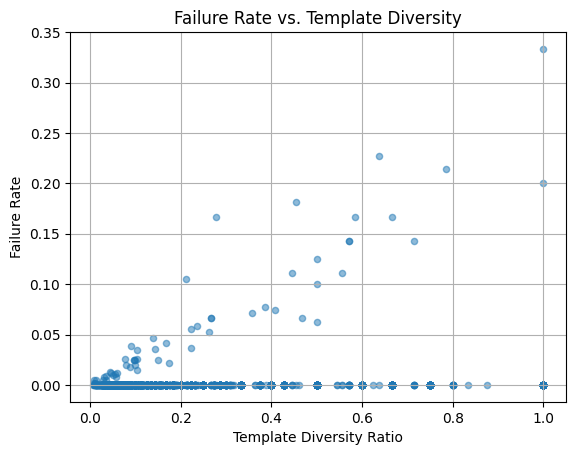

/tmp/ipykernel_83211/4112593840.py:24: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  print(firm_analysis.groupby("firm_size_bin")["failure_rate"].describe())


                 count      mean       std  min  25%      50%       75%  \
firm_size_bin                                                             
1–5            11877.0  0.000017  0.001835  0.0  0.0  0.00000  0.000000   
6–10            1488.0  0.000925  0.012944  0.0  0.0  0.00000  0.000000   
11–25            790.0  0.002128  0.017185  0.0  0.0  0.00000  0.000000   
26–50            197.0  0.001695  0.008158  0.0  0.0  0.00000  0.000000   
51–100            82.0  0.002687  0.007683  0.0  0.0  0.00000  0.000000   
101–500           32.0  0.001444  0.003287  0.0  0.0  0.00000  0.000000   
500+               7.0  0.002034  0.002331  0.0  0.0  0.00189  0.003569   

                    max  
firm_size_bin            
1–5            0.200000  
6–10           0.333333  
11–25          0.227273  
26–50          0.074074  
51–100         0.038462  
101–500        0.012821  
500+           0.005208  


In [88]:
# Merge failure counts into firm_template_map
firm_failure_counts = (
    lp_df[lp_df["is_failure"] == 1].groupby("firm").size().rename("failures")
)
firm_analysis = firm_template_map.merge(
    firm_failure_counts, on="firm", how="left"
).fillna({"failures": 0})

# Compute failure rate per firm
firm_analysis["failure_rate"] = (
    firm_analysis["failures"] / firm_analysis["num_investors"]
)

# Plot failure rate vs template diversity
firm_analysis.plot.scatter(x="diversity_ratio", y="failure_rate", alpha=0.5)
plt.title("Failure Rate vs. Template Diversity")
plt.xlabel("Template Diversity Ratio")
plt.ylabel("Failure Rate")
plt.grid(True)
plt.show()

# Bucket firms by investor count
firm_analysis["firm_size_bin"] = pd.cut(
    firm_analysis["num_investors"],
    bins=[0, 5, 10, 25, 50, 100, 500, 10000],
    labels=["1-5", "6-10", "11-25", "26-50", "51-100", "101-500", "500+"],
)

# Failure rate per firm size bin
print(firm_analysis.groupby("firm_size_bin")["failure_rate"].describe())

Understandably, template diversity negatively affects our results with the scatter plot showing a positive correlation between the two. Firm size seems to affect this but begins to normalise after a while. This is probably due to the increased likelihood of more diverse investors (and therefore different naming conventions) as the firm gets larger.

In [99]:
# Ensure failure flag is in the DataFrame
lp_df["is_failure"] = lp_df["id"].isin(failed_ids)

# Convert token_seq list to a string so it can be grouped
lp_df["token_seq_str"] = lp_df["token_seq"].apply(json.dumps)

# Now group and count failures by template string
failed_templates = (
    lp_df[lp_df["is_failure"]]
    .groupby("token_seq_str")
    .size()
    .rename("fail_count")
    .reset_index()
    .sort_values("fail_count", ascending=False)
)

# Preview
print(failed_templates.shape[0])
failed_templates

42


,token_seq_str,fail_count
24,"[""first_original_0"", ""l_0""]",7
25,"[""first_original_0"", ""last_original_0""]",6
27,"[""first_original_0"", ""middle_original_0"", ""."",...",4
19,"[""first_original_0"", ""."", ""last_original_0""]",4
37,"[""last_original_0""]",4
28,"[""first_original_0"", ""middle_original_0"", ""las...",4
3,"[""f_0"", ""f_0"", ""last_original_0""]",4
21,"[""first_original_0"", ""first_original_1"", ""."", ...",3
10,"[""f_0"", ""last_original_0""]",3
6,"[""f_0"", ""f_1"", ""last_original_0""]",3


These are the failing templates, largely edge cases. I think the way forward is training separate models on complex names (i.e., `uses_multiple_firsts`, `uses_multiple_middles`, `uses_multiple_lasts` is set true). 

Before this, we want to bring in back the previous normalization tokens to see how the model performs when predicting normalisation efforts. There has also been new data made available that need to be merged in.

We achieve largely the same scores with the new candidate templates. This points to the fact that we can reliably predict normalization techniques in the investors name as well as syntactic template. 

I would like to now and try and split the data, one majority dataset holding typical "First Name - Second Name" named investors, the other with complex names. We have the necessary flags in `lp_clean` to do this, after we will have to get two candidate template lists to match with both of the split datasets and generate two feature matrices. We will do the same padding and even attempt more aggressive augmentation to improve our results.

In [14]:
# Define complex flags
complex_flags = [
    "has_multiple_first_names",
    "has_middle_name",
    "has_multiple_middle_names",
    "has_multiple_last_names",
    "has_nfkd_normalized",
    "has_german_char",
]

# Create a single column flag
lp_df["is_name_complex"] = lp_df[complex_flags].any(axis=1)

# Split into two datasets
complex_name_df = lp_df[lp_df["is_name_complex"]].copy()
standard_name_df = lp_df[~lp_df["is_name_complex"]].copy()

print(f"Complex names: {len(complex_name_df)}")
print(f"Standard names: {len(standard_name_df)}")
print(lp_df["is_name_complex"].value_counts(normalize=True))

Complex names: 4000
Standard names: 69918
is_name_complex
False    0.945886
True     0.054114
Name: proportion, dtype: float64


Unbelievably there are exactly 4000 complex names in the dataset. Let's look at a few of them to confirm.

In [17]:
complex_name_df["investor"].head(20), standard_name_df["investor"].head(20),

(69      pauline voorden-bijvoet
 81         alana terese calairo
 123           romeo di battista
 159            sultan al lahham
 177      victoria george-taylor
 198            nahla sturm-wang
 232           james-keith brown
 244             salah al janahi
 248          ritva aula-sjolund
 273          marie-laure hespel
 298         oliver hedley-whyte
 368     franã§ois-xavier masson
 656              fã¡bio vidigal
 698        tristan reis-freeman
 801            franã§ois sunier
 932             john ross-munro
 985            michael a sabota
 1047              sã¡vio barros
 1072        anne bejui-thivolet
 1241    catherine bellin-schulz
 Name: investor, dtype: object,
 0              anja brors
 1            cory berceau
 2       michael fisherman
 3       sherwin zuckerman
 4             luca schmid
 5         guillaume waser
 6     reinhold zimmermann
 7       niels zibrandtsen
 8            penghui wang
 9         michael mielach
 10           alex dirksen
 11        

Certainly looks right, lets create two candidate template lists.

In [24]:
# JSON safe string form of token_seq
complex_name_df["token_seq_str"] = complex_name_df["token_seq"].apply(json.dumps)
standard_name_df["token_seq_str"] = standard_name_df["token_seq"].apply(json.dumps)
candidate_templates["token_seq_str"] = candidate_templates["template"].apply(json.dumps)

# Unique sequences seen in each subset
complex_token_set = set(complex_name_df["token_seq_str"])
standard_token_set = set(standard_name_df["token_seq_str"])

# Filter candidate_templates
complex_templates = candidate_templates[
    candidate_templates["template"].isin(complex_token_set)
].copy()
standard_templates = candidate_templates[
    candidate_templates["template"].isin(standard_token_set)
].copy()

print(f"Complex templates: {len(complex_templates)}")
print(f"Standard templates: {len(standard_templates)}")

Complex templates: 355
Standard templates: 79


Heavily skewed to the complex case, we will have to aggressively pad the complex case. This explains our near perfect results and slow training. Training seems to find the optimum within a few training rounds, this probably because of our long tail template distribution where the majority of investors are covered by only a few templates. Whereas the complexly named investors use a variety of templates, this makes it much harder for the model to predict at the edge cases.

In [ ]:
# More aggressive padding
low_investor_firms = firm_template_map[firm_template_map["num_investors"] < 10][
    "firm"
].tolist()

# Build firm profiles for each data set
firm_profiles_std = [
    build_firm_profile(firm, standard_name_df, firm_template_map, standard_templates)
    for firm in low_investor_firms
]
firm_profiles_com = [
    build_firm_profile(firm, complex_name_df, firm_template_map, complex_templates)
    for firm in low_investor_firms
]

# Padd both with synthetic
std_augmented = padd_with_synthetic(standard_name_df, firm_profiles_std, n_pad=20)
complex_augmented = padd_with_synthetic(complex_name_df, firm_profiles_com, n_pad=20)

# Get splits for both
_, val, test = split_clean_ids(standard_name_df, test_ratio=0.1, validation_ratio=0.2)
pd.DataFrame({"validation_ids": val}).to_csv("validation_std_ids.csv")
all_ids = std_augmented["id"].to_list()
train = list(set(all_ids) - set(val) - set(test))
pd.DataFrame({"train_ids": train}).to_csv("train_std_ids.csv")
_, val, test = split_clean_ids(complex_name_df, test_ratio=0.1, validation_ratio=0.2)
pd.DataFrame({"validation_ids": val}).to_csv("validation_com_ids.csv")
all_ids = complex_augmented["id"].to_list()
train = list(set(all_ids) - set(val) - set(test))
pd.DataFrame({"train_ids": train}).to_csv("train_com_ids.csv")